# Title: Medicine Strip identification for Visually Impaired People

# Data set(Directory of images)

# There is no dataset directly available so we are considering 20 images from the internet and storing them in a directory

# Directory Path: r"C:\\Users\\santo\\Desktop\\python\\finaldata1"

# Displaying images(Data set)

In [8]:
import os
import requests
from bs4 import BeautifulSoup
from urllib.parse import urljoin, urlparse
from urllib.request import urlretrieve
import re

# Function to sanitize a filename
def sanitize_filename(filename):
    # Remove any characters that are not alphanumeric or whitespace
    filename = re.sub(r'[^\w\s-]', '', filename)
    # Replace whitespace with underscores
    filename = re.sub(r'[\s]', '_', filename)
    return filename

# Function to download images
def download_images(url, output_folder):
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Iterate over image elements and download them
    for img_tag in soup.find_all('img'):
        img_url = img_tag['src']
        img_url = urljoin(url, img_url)

        # Get the image content
        img_response = requests.get(img_url)
        # Get the filename from the URL
        img_filename = os.path.basename(urlparse(img_url).path)
        
        # Sanitize the filename
        img_filename = sanitize_filename(img_filename)
        
        # Save the image
        img_path = os.path.join(output_folder, img_filename)
        with open(img_path, 'wb') as img_file:
            img_file.write(img_response.content)
            print(f"Downloaded: {img_url} -> {img_path}")

# URL of the webpage containing images
#webpage_url = "https://example.com"  # Replace with the URL of the webpage
webpage_url = "https://www.google.com/search?sca_esv=569667915&sxsrf=AM9HkKlPOK39aAlyAaMNxEI-6CTE595o0Q:1696057020011&q=medicine+strip+images+pharmeasy&tbm=isch&source=univ&fir=88r0Ip9SHPuFQM%252CmdZYTL-LqQbWFM%252C_%253BHFGbIvBfP6NJjM%252Cbc4WfM6bsKMEiM%252C_%253Bd98JnHSyemJxkM%252CdiZUp7wEx51YGM%252C_%253BtaNAnbbNLYZvdM%252CnYhGt4ZuGf1FrM%252C_%253BolTKtah1Y3Ki5M%252CylPtJ2dmKbRopM%252C_%253Bs7mgFF81UXIc6M%252CSUsRGp8K5AMiWM%252C_%253BXnGPdpnjpKTtQM%252CylPtJ2dmKbRopM%252C_%253B8PQ2v3upAM68LM%252C9rBIYkemJMjcvM%252C_%253B5o5znnx2cjGaVM%252CSUsRGp8K5AMiWM%252C_%253BJFKe0Fn7fkicMM%252CSUsRGp8K5AMiWM%252C_&usg=AI4_-kQD-SrlRDPXU4QNChpsR2V67sSOEw&sa=X&ved=2ahUKEwje5sjh4NGBAxWBTWwGHbInAUYQjJkEegQIERAC&biw=1280&bih=610&dpr=1.5#imgrc=Ilqy26AdH5EuDM"  # Replace with the URL of the webpage
# Output folder to save images
output_folder = "webscrapimages"  # Folder where images will be saved
# Download images
download_images(webpage_url, output_folder)


Downloaded: https://www.google.com/images/branding/searchlogo/1x/googlelogo_desk_heirloom_color_150x55dp.gif -> webscrapimages\googlelogo_desk_heirloom_color_150x55dpgif
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRks1-sctf6x_WpQM-pLgd7C1ppCVIAlt69QFjHmwAwWM5ti02h5zz113CEmw&s -> webscrapimages\images
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTyvHow_DK4exAxJ_xSDSWZ-G56XmgszIMAHfOgREXM7DWE-K_LyeXYnNJB4A&s -> webscrapimages\images
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTyyJEvPWY3V62GBZ797ImT1sUVhGNJQgZC-_jsDe5leC2kWYbwkaXF_a8NQIs&s -> webscrapimages\images
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQpwrXfNDumtqJGetpmHRDD-i0zybUk42E7NsU0wOxJ7kdhnybsMnAMMqrPVw&s -> webscrapimages\images
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRMUR4CmsxBCO7iC_iXqIwpISMbYBh0WruZirnV295pSytFFlvHXHy51RTFyPc&s -> webscrapimages\images
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tb

In [9]:
import os
import requests
from bs4 import BeautifulSoup
from urllib.parse import urlparse, urljoin
def download_images(url, output_folder, num_images_to_download=100):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    response = requests.get(url)
    soup = BeautifulSoup(response.content, 'html.parser')

    img_tags = soup.find_all('img')[:num_images_to_download]

    for i, img_tag in enumerate(img_tags):
        img_url = img_tag['src']
        img_url = urljoin(url, img_url)

        img_response = requests.get(img_url)

        if img_response.status_code == 200:
            img_filename = f"image_{i}.jpg"  # Generate a filename based on the image number
            img_path = os.path.join(output_folder, img_filename)

            with open(img_path, 'wb') as img_file:
                img_file.write(img_response.content)
                print(f"Downloaded: {img_url} -> {img_path}")
        else:
            print(f"Failed to download: {img_url}")/
# Example usage
webpage_url = "https://www.google.com/search?q=medicine+strip+images&tbm=isch"
output_folder = "onlineimages"
num_images_to_download = 200  # Change this to the desired number of images
download_images(webpage_url, output_folder, num_images_to_download)


Downloaded: https://www.google.com/images/branding/searchlogo/1x/googlelogo_desk_heirloom_color_150x55dp.gif -> onlineimages\image_0.jpg
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcSut1DsPzF8pHT8LS6RXeYTsDLpuQXTrrNXrQmbrLXuz43_m18u8j2RIQeezQo&s -> onlineimages\image_1.jpg
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRcB1H71OS7McU_lDfmJDnqvqnZ1NnYUyt5N3y1AY3gpNy_cxofnX5emzxdag&s -> onlineimages\image_2.jpg
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRj9PXmdxzgxK9svtDd8HLPs4H7NUPxrCRom_aiL7UcrOEpRyxV4fW2D-gJfVQ&s -> onlineimages\image_3.jpg
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQSYWlOYC-klZSNb82BaMqnGT-9KeJRK1cZtQVHLFJFrg2vkVBcMZWfA7CWwrI&s -> onlineimages\image_4.jpg
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcQs95zldSlhBT1GCmi1Gdf0ieNzof7muuaD8JaZNkPNd9pM8piG9ZRd-TRkooU&s -> onlineimages\image_5.jpg
Downloaded: https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcT_PZ5_Vo

Image Name: Beta-Nicardia.png, Label: finaldata1
Image Name: Calcijoint.png, Label: finaldata1
Image Name: Caldrive.png, Label: finaldata1
Image Name: Citrizine.png, Label: finaldata1
Image Name: Coldact.png, Label: finaldata1
Image Name: Debrilyse.png, Label: finaldata1
Image Name: Deemol.png, Label: finaldata1
Image Name: Dolamide.png, Label: finaldata1
Image Name: Evidox.png, Label: finaldata1
Image Name: Lovax.png, Label: finaldata1
Image Name: Monosprin.png, Label: finaldata1
Image Name: Naprosyn.png, Label: finaldata1
Image Name: Nexonerve.png, Label: finaldata1
Image Name: Onitaz-Forte.png, Label: finaldata1
Image Name: Palozac.png, Label: finaldata1
Image Name: Paracetamol.png, Label: finaldata1
Image Name: Prizide.png, Label: finaldata1
Image Name: Texof.png, Label: finaldata1
Image Name: Trental.png, Label: finaldata1
Image Name: Tricium-plus.png, Label: finaldata1


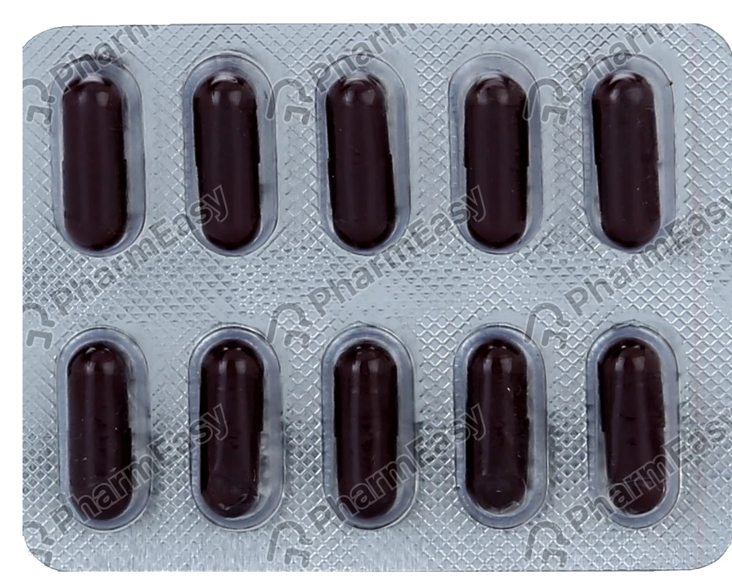

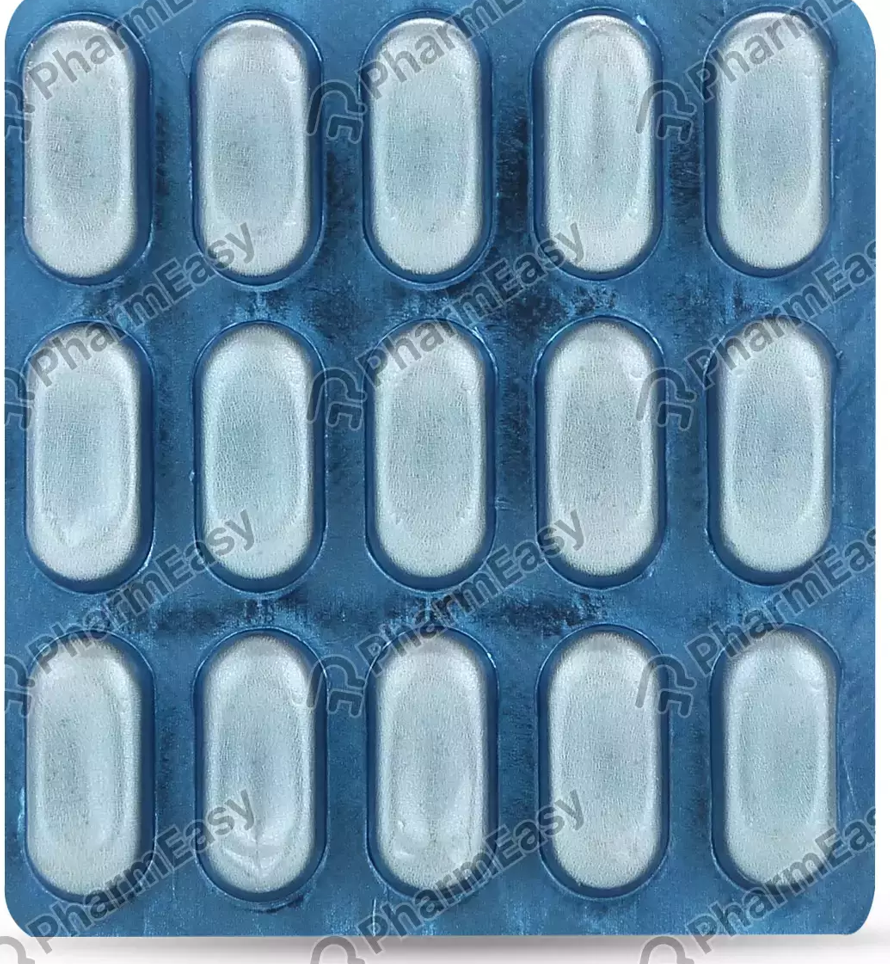

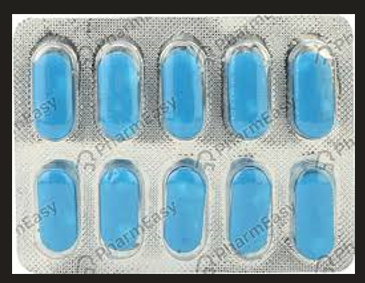

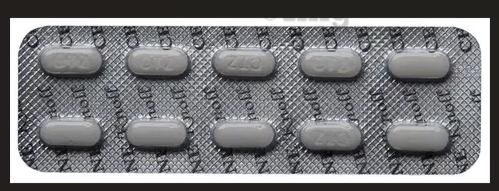

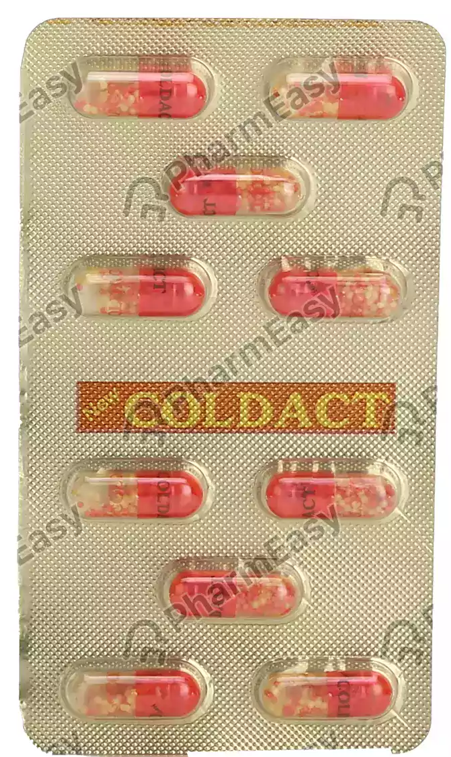

...

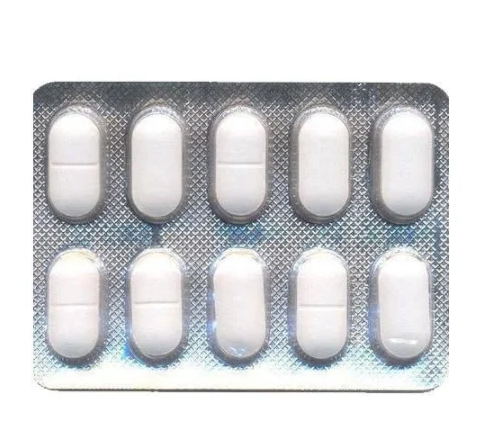

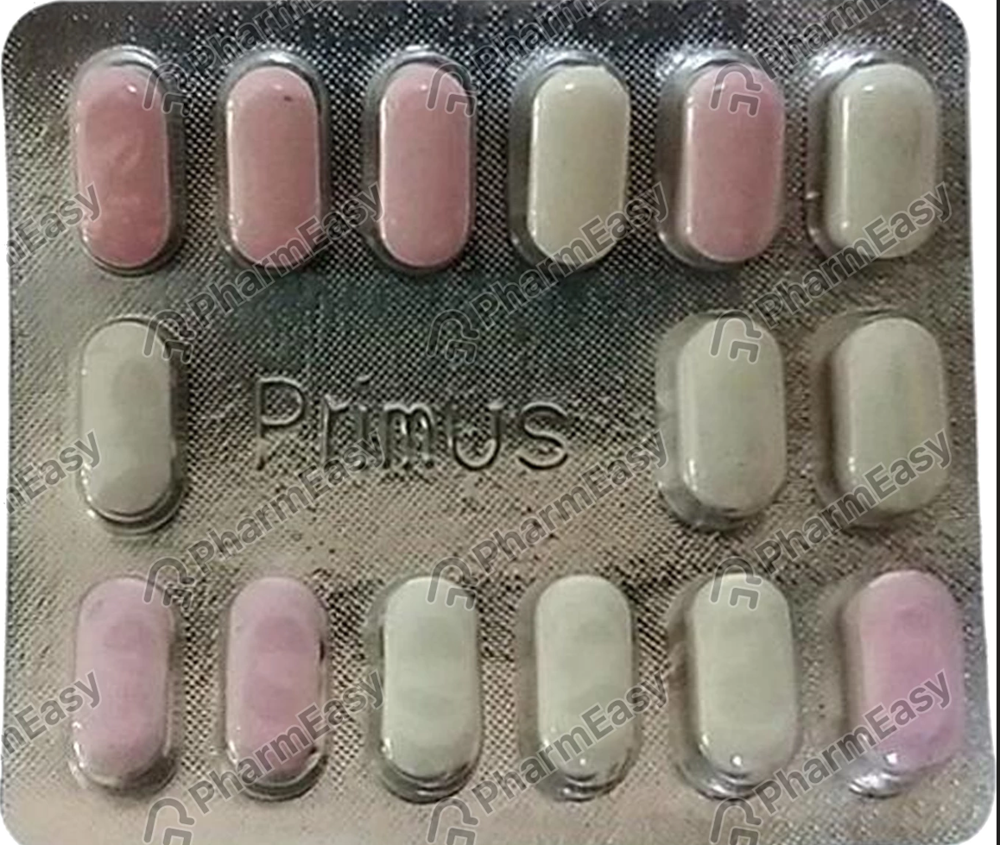

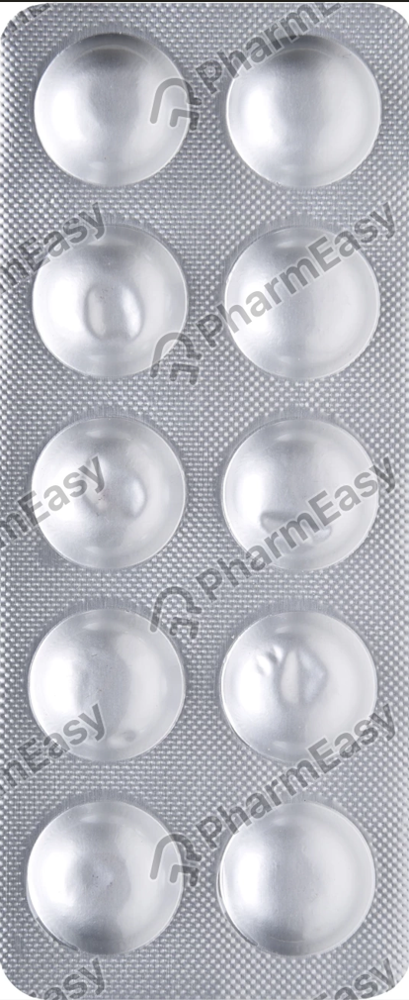

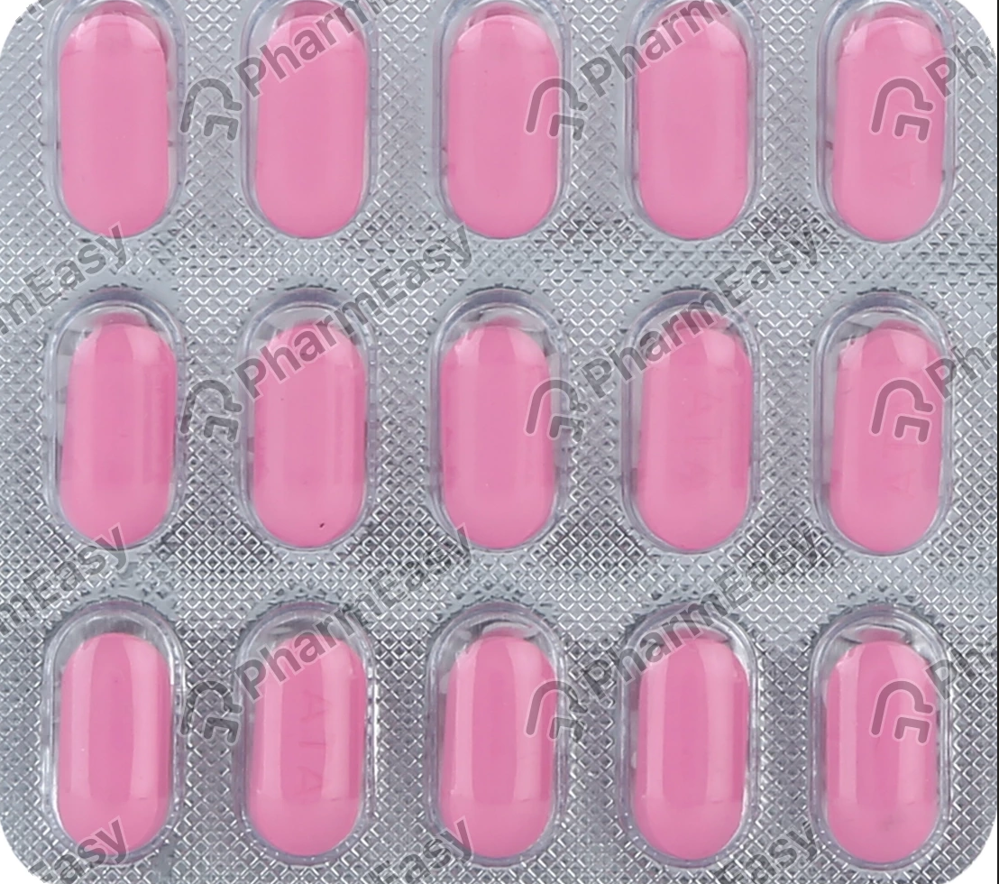

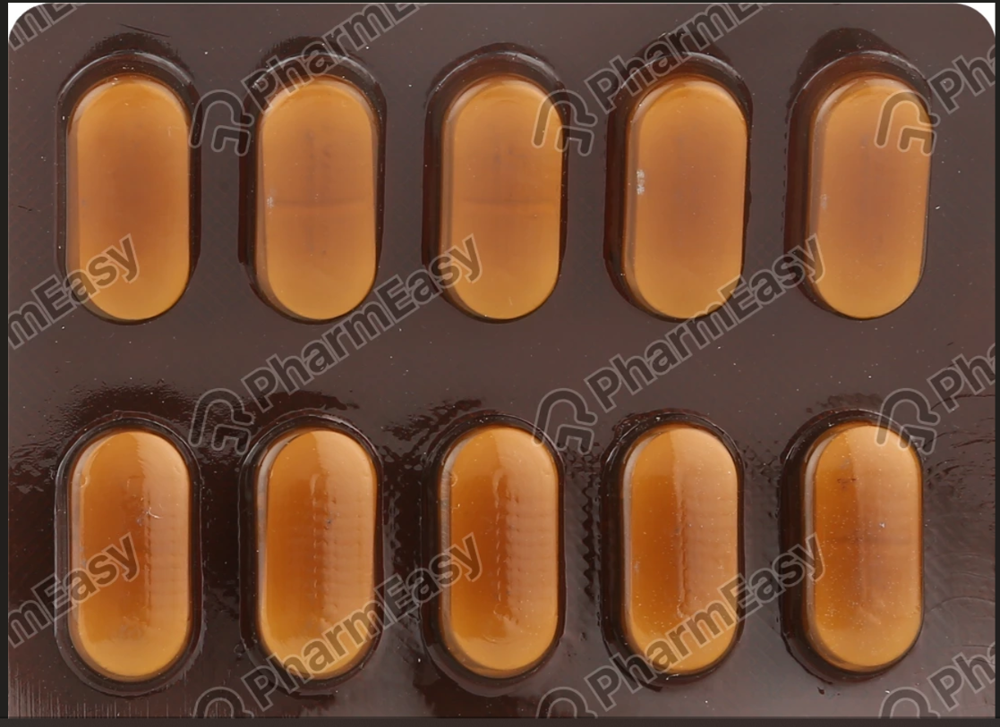

In [1]:
import os
import cv2
import numpy as np
from IPython.display import display, Image
# Specify the images directory
images_directory = r"C:\\Users\\santo\\Desktop\\python\\finaldata1"

def display_images_by_name(images_directory):
    for root, _, files in os.walk(images_directory):
        for file in files:
            # Check if the file is an image (with specified extensions)
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                label = os.path.basename(root)
                image_path = os.path.join(root, file)
                print(f"Image Name: {file}, Label: {label}")

# Display images by name and label
display_images_by_name(images_directory)
image_files = [f for f in os.listdir(images_directory) if os.path.isfile(os.path.join(images_directory, f))]
#appended_image_files = [f for f in os.listdir(appended_images_directory) if os.path.isfile(os.path.join(appended_images_directory, f))] #ppended_image_files = [f for f in os.listdir(appended_images_directory) if os.path.isfile(os.path.join(appended_images_directory, f))]
# Display the images
for image_file in image_files:
    display(Image(filename=os.path.join(images_directory, image_file)))


# Preprocessing of images

# Grayscale Conversion

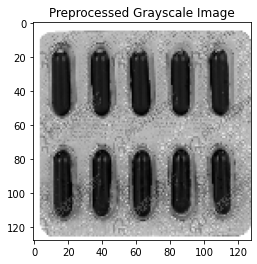

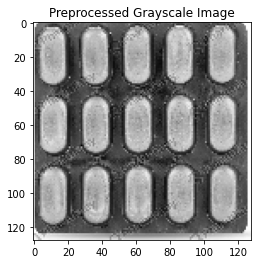

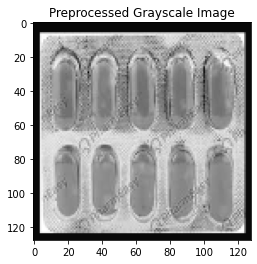

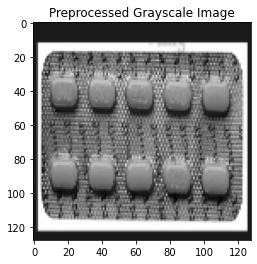

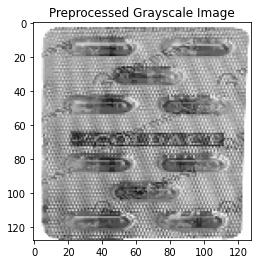

...

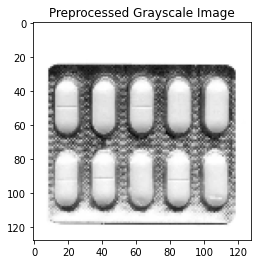

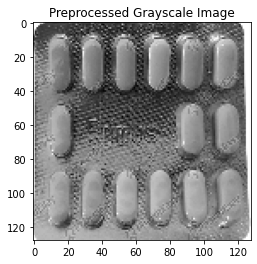

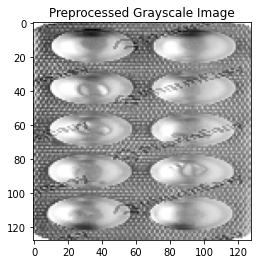

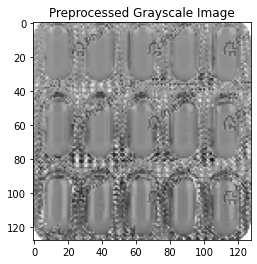

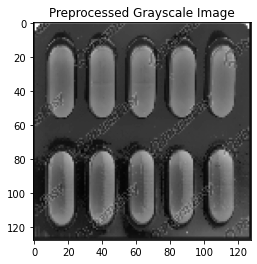

Successfully loaded, preprocessed, and saved grayscale images.


In [11]:
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt

# Function to convert an image to grayscale
def convert_to_grayscale(image):
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return grayscale_image

# Function to load and preprocess images with grayscale conversion
def load_and_preprocess_images_grayscale(images_directory, output_directory, extensions=('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
    # Create the output directory if it doesn't exist
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    for root, _, files in os.walk(images_directory):
        for file in files:
            if file.lower().endswith(extensions):
                label = os.path.basename(root)
                image_path = os.path.join(root, file)
                # Load the image using OpenCV
                image = cv2.imread(image_path)
                # Convert the image to grayscale
                grayscale_image = convert_to_grayscale(image)
                # Resize the grayscale image to a desired size (e.g., 128x128)
                grayscale_resized = cv2.resize(grayscale_image, (128, 128))
                # Normalize the pixel values to be in the range [0, 1]
                grayscale_normalized = grayscale_resized.astype(np.float32) / 255.0

                # Save the preprocessed image to the output directory
                output_path = os.path.join(output_directory, label)
                if not os.path.exists(output_path):
                    os.makedirs(output_path)
                output_file_path = os.path.join(output_path, file)
                cv2.imwrite(output_file_path, (grayscale_normalized * 255).astype(np.uint8))

                # Display the preprocessed grayscale image
                plt.imshow(grayscale_normalized, cmap='gray')
                plt.title('Preprocessed Grayscale Image')
                plt.show()

# Specify the images directory and the output directory for preprocessed images
images_directory = "C:\\Users\\santo\\Desktop\\python\\finaldata1"
output_directory = "C:\\Users\\santo\\Desktop\\python\\preprocessed_images"

# Load and preprocess images with grayscale conversion and save them to the output directory
try:
    load_and_preprocess_images_grayscale(images_directory, output_directory)
    print("Successfully loaded, preprocessed, and saved grayscale images.")
except ValueError as e:
    print(str(e))


# Resizing

Successfully loaded, preprocessed, and saved resized images.


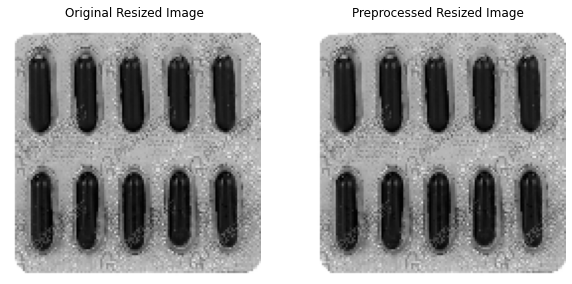

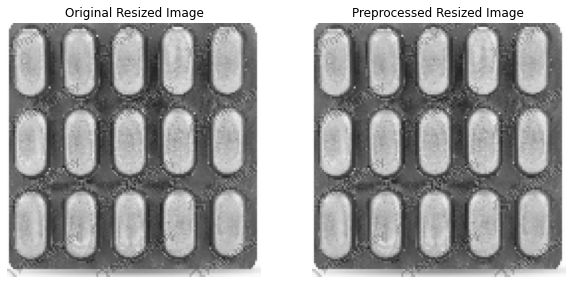

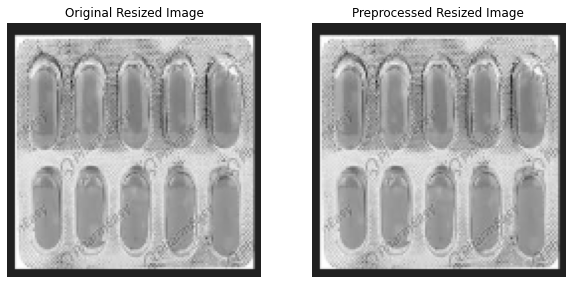

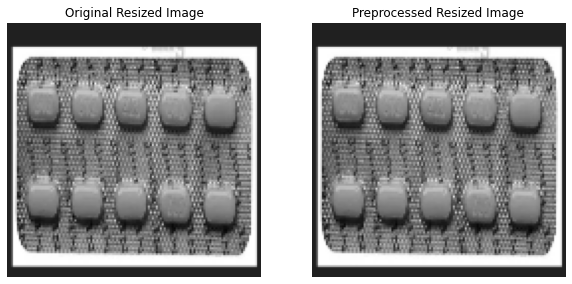

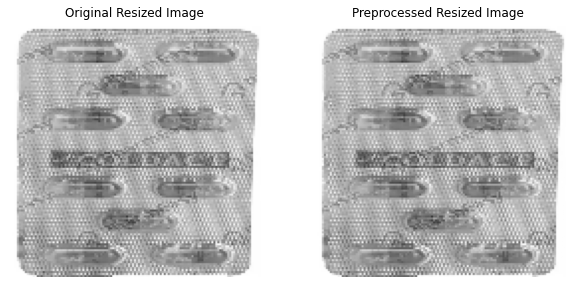

In [12]:
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt

# Function to resize an image
def resize_image(image, width, height):
    resized_image = cv2.resize(image, (width, height))
    return resized_image

# Function to load and preprocess images with resizing
def load_and_preprocess_images_resized(images_directory, target_width, target_height, output_directory, extensions=('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
    # Create the output directory if it doesn't exist
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    images = []
    labels = []
    
    for root, _, files in os.walk(images_directory):
        for file in files:
            if file.lower().endswith(extensions):
                label = os.path.basename(root)
                image_path = os.path.join(root, file)
                # Load the image using OpenCV
                image = cv2.imread(image_path)
                # Resize the image to the target width and height
                resized_image = resize_image(image, target_width, target_height)
                # Normalize the pixel values to be in the range [0, 1]
                resized_normalized = resized_image.astype(np.float32) / 255.0
                
                # Save the preprocessed image to the output directory
                output_path = os.path.join(output_directory, label)
                if not os.path.exists(output_path):
                    os.makedirs(output_path)
                output_file_path = os.path.join(output_path, file)
                cv2.imwrite(output_file_path, (resized_normalized * 255).astype(np.uint8))

                images.append((resized_image, resized_normalized))
                labels.append(label)
                
    if len(images) == 0:
        raise ValueError("No valid images (with specified extensions) were found in the specified directory.")
    
    return images, np.array(labels)

# Specify the images directory and the output directory for preprocessed images
images_directory = "C:\\Users\\santo\\Desktop\\python\\preprocessed_images\\finaldata1"
output_directory = "C:\\Users\\santo\\Desktop\\python\\preprocessed_images_resized"

# Load and preprocess images with resizing and save them to the output directory
try:
    resized_images, resized_labels = load_and_preprocess_images_resized(images_directory, 128, 128, output_directory)
    print("Successfully loaded, preprocessed, and saved resized images.")
except ValueError as e:
    print(str(e))

# Display original and preprocessed resized images
num_images_to_display = 5

for i in range(num_images_to_display):
    original_image, preprocessed_image = resized_images[i]
    
    plt.figure(figsize=(10, 5))
    
    # Display original image (resized)
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.title('Original Resized Image')
    plt.axis('off')
    
    # Display preprocessed resized image
    plt.subplot(1, 2, 2)
    plt.imshow(preprocessed_image)
    plt.title('Preprocessed Resized Image')
    plt.axis('off')
    
    plt.show()


# Constrast Enhancement

Successfully loaded, preprocessed, and saved images with contrast enhancement.


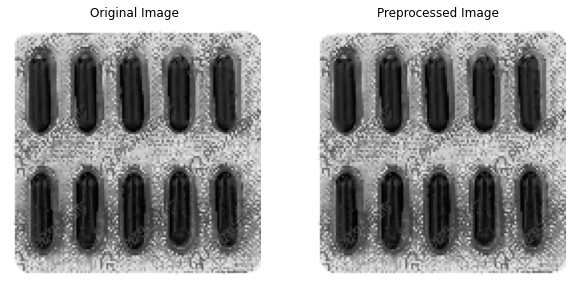

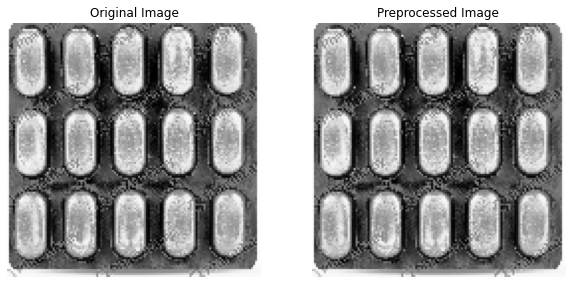

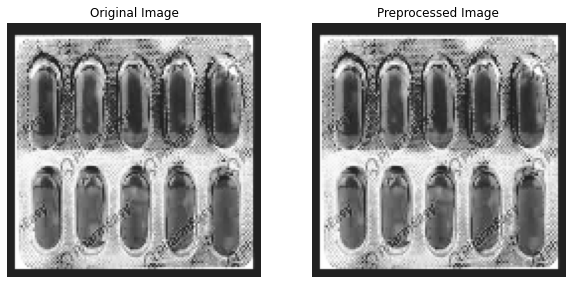

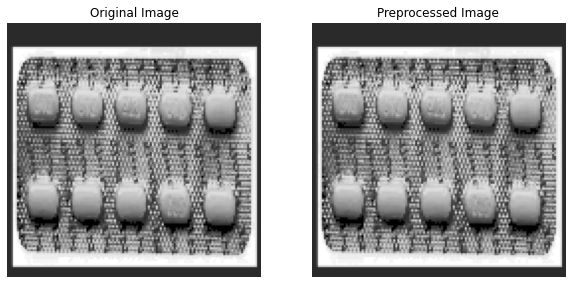

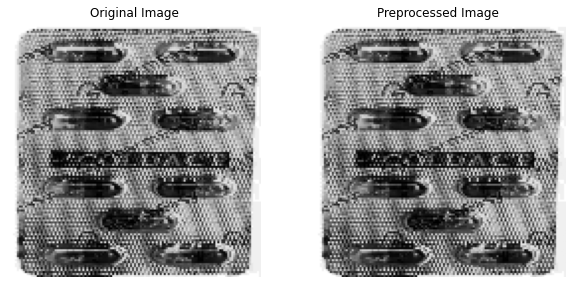

In [13]:
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt

# Function to resize an image
def resize_image(image, width, height):
    resized_image = cv2.resize(image, (width, height))
    return resized_image

# Function to enhance contrast using histogram equalization
def enhance_contrast(image):
    # Convert the image to grayscale
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Apply histogram equalization
    enhanced_image = cv2.equalizeHist(grayscale_image)
    
    # Stack enhanced grayscale image to 3 channels to make it compatible with the original
    enhanced_image = cv2.merge([enhanced_image, enhanced_image, enhanced_image])
    return enhanced_image

# Function to load and preprocess images with resizing and contrast enhancement
def load_and_preprocess_images(images_directory, target_width, target_height, output_directory, extensions=('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
    # Create the output directory if it doesn't exist
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    images = []
    labels = []
    
    for root, _, files in os.walk(images_directory):
        for file in files:
            if file.lower().endswith(extensions):
                label = os.path.basename(root)
                image_path = os.path.join(root, file)
                # Load the image using OpenCV
                image = cv2.imread(image_path)
                # Enhance contrast
                enhanced_image = enhance_contrast(image)
                # Resize the image to the target width and height
                resized_image = resize_image(enhanced_image, target_width, target_height)
                # Normalize the pixel values to be in the range [0, 1]
                resized_normalized = resized_image.astype(np.float32) / 255.0
                
                # Save the preprocessed image to the output directory
                output_path = os.path.join(output_directory, label)
                if not os.path.exists(output_path):
                    os.makedirs(output_path)
                output_file_path = os.path.join(output_path, file)
                cv2.imwrite(output_file_path, (resized_normalized * 255).astype(np.uint8))

                images.append((resized_image, resized_normalized))
                labels.append(label)
                
    if len(images) == 0:
        raise ValueError("No valid images (with specified extensions) were found in the specified directory.")
    
    return images, np.array(labels)

# Specify the images directory and the output directory for preprocessed images
images_directory = "C:\\Users\\santo\\Desktop\\python\\preprocessed_images_resized\\finaldata1"
output_directory = "C:\\Users\\santo\\Desktop\\python\\preprocessed_images_contrast_enhanced"

# Load and preprocess images with resizing and contrast enhancement, and save them to the output directory
try:
    preprocessed_images, preprocessed_labels = load_and_preprocess_images(images_directory, 128, 128, output_directory)
    print("Successfully loaded, preprocessed, and saved images with contrast enhancement.")
except ValueError as e:
    print(str(e))

# Display original and preprocessed images
num_images_to_display = 5

for i in range(num_images_to_display):
    original_image, preprocessed_image = preprocessed_images[i]
    
    plt.figure(figsize=(10, 5))
    
    # Display original image
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('off')
    
    # Display preprocessed image
    plt.subplot(1, 2, 2)
    plt.imshow(preprocessed_image)
    plt.title('Preprocessed Image')
    plt.axis('off')
    
    plt.show()


# Edge Enhancement

Successfully loaded, preprocessed, and saved images with edge enhancement.


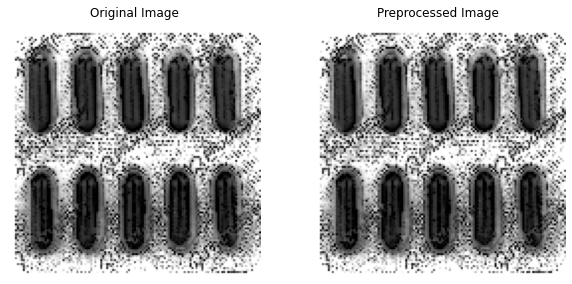

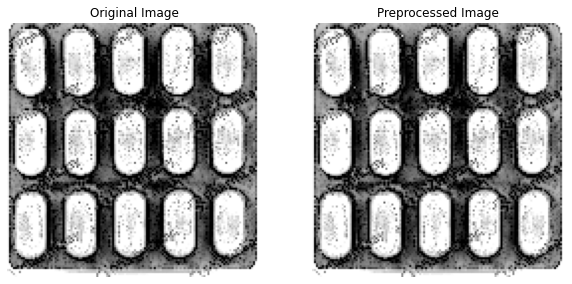

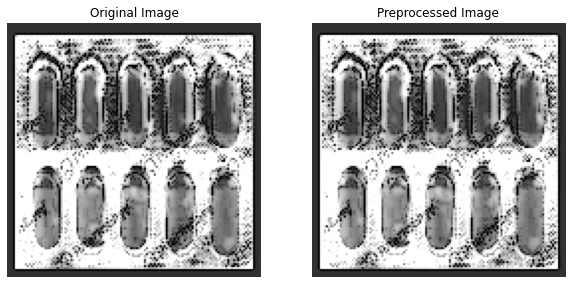

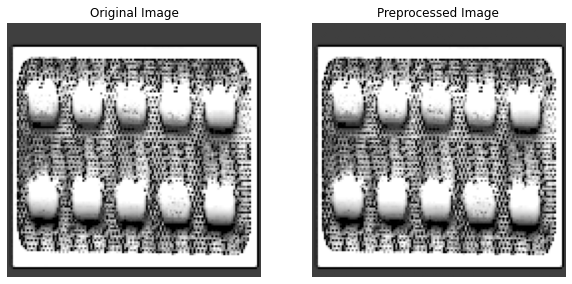

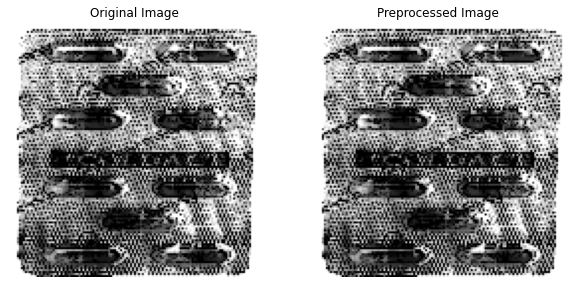

In [14]:
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt

# Function to resize an image
def resize_image(image, width, height):
    resized_image = cv2.resize(image, (width, height))
    return resized_image

# Function to enhance edges using Laplacian filter
import cv2

def enhance_edges(image):
    # Convert the image to grayscale
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Convert grayscale image to float32 type
    grayscale_image_float32 = grayscale_image.astype('float32')
    
    # Calculate the Laplacian to enhance edges
    laplacian_image = cv2.Laplacian(grayscale_image_float32, cv2.CV_32F)
    
    # Convert Laplacian image back to uint8 type
    laplacian_image_uint8 = cv2.convertScaleAbs(laplacian_image)
    
    # Add the Laplacian image to the original image to enhance edges
    enhanced_image = cv2.addWeighted(grayscale_image, 1.5, laplacian_image_uint8, -0.5, 0)
    
    # Stack enhanced grayscale image to 3 channels to make it compatible with the original
    enhanced_image = cv2.merge([enhanced_image, enhanced_image, enhanced_image])
    
    return enhanced_image


# Function to load and preprocess images with resizing and edge enhancement
def load_and_preprocess_images(images_directory, target_width, target_height, output_directory, extensions=('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
    # Create the output directory if it doesn't exist
    if not os.path.exists(output_directory):
        os.makedirs(output_directory)

    images = []
    labels = []
    
    for root, _, files in os.walk(images_directory):
        for file in files:
            if file.lower().endswith(extensions):
                label = os.path.basename(root)
                image_path = os.path.join(root, file)
                # Load the image using OpenCV
                image = cv2.imread(image_path)
                # Enhance edges
                enhanced_image = enhance_edges(image)
                # Resize the image to the target width and height
                resized_image = resize_image(enhanced_image, target_width, target_height)
                # Normalize the pixel values to be in the range [0, 1]
                resized_normalized = resized_image.astype(np.float32) / 255.0
                
                # Save the preprocessed image to the output directory
                output_path = os.path.join(output_directory, label)
                if not os.path.exists(output_path):
                    os.makedirs(output_path)
                output_file_path = os.path.join(output_path, file)
                cv2.imwrite(output_file_path, (resized_normalized * 255).astype(np.uint8))

                images.append((resized_image, resized_normalized))
                labels.append(label)
                
    if len(images) == 0:
        raise ValueError("No valid images (with specified extensions) were found in the specified directory.")
    
    return images, np.array(labels)

# Specify the images directory and the output directory for preprocessed images
images_directory = "C:\\Users\\santo\\Desktop\\python\\preprocessed_images_contrast_enhanced"
output_directory = "C:\\Users\\santo\\Desktop\\python\\preprocessed_images_edge_enhanced"

# Load and preprocess images with resizing and edge enhancement, and save them to the output directory
try:
    preprocessed_images, preprocessed_labels = load_and_preprocess_images(images_directory, 128, 128, output_directory)
    print("Successfully loaded, preprocessed, and saved images with edge enhancement.")
except ValueError as e:
    print(str(e))

# Display original and preprocessed images
num_images_to_display = 5

for i in range(num_images_to_display):
    original_image, preprocessed_image = preprocessed_images[i]
    
    plt.figure(figsize=(10, 5))
    
    # Display original image
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('off')
    
    # Display preprocessed image
    plt.subplot(1, 2, 2)
    plt.imshow(preprocessed_image)
    plt.title('Preprocessed Image')
    plt.axis('off')
    
    plt.show()

In [5]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from shutil import copyfile
# ... Rest of the code for SIFT feature extraction, train-test split, and model training ...
 #Function to extract SIFT features from images
def extract_sift_features(image_path):
    image = cv2.imread(image_path)
    # Downsample the image to a smaller size
    image = cv2.resize(image, (0, 0), fx=0.5, fy=0.5)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return descriptors
# Specify the images directory
images_directory = r"C:\\Users\\santo\\Desktop\\python\\finaldata2"

# Load images, extract SIFT features, and prepare features and labels
features = []
labels = []

# Loop through the image files
for file in os.listdir(images_directory):
    image_path = os.path.join(images_directory, file)
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Use the image name (excluding extension) as the label
        label = os.path.splitext(file)[0]
        features.extend(descriptors)
        labels.extend([label] * len(descriptors))

# Convert features and labels to numpy arrays
features = np.array(features)
labels = np.array(labels)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

# Train a machine learning model (SVM in this example)
model = SVC()
model.fit(X_train, y_train)

# Predict labels for the test set
predictions = model.predict(X_test)

# Evaluate the model (you can use classification metrics)
accuracy = np.mean(predictions == y_test)
print("Test Accuracy:", accuracy)
# ... Rest of the code ...

# Create directories to save images
train_images_directory = "train_images"
test_images_directory = "test_images"

# Check if the directories exist, if not, create them
if not os.path.exists(train_images_directory):
    os.makedirs(train_images_directory)

if not os.path.exists(test_images_directory):
    os.makedirs(test_images_directory)


def save_images(images, labels, destination_directory):
    for i, image in enumerate(images):
        # Get the label for this image
        label = labels[i]
        # Create the destination path
        destination_path = os.path.join(destination_directory, f"{label}_{i}.jpg")
        # Save the image
        cv2.imwrite(destination_path, image)

# Save training images
save_images(X_train, y_train, train_images_directory)
# Save testing images
save_images(X_test, y_test, test_images_directory)

print("Training images saved to:", os.path.abspath(train_images_directory))
print("Testing images saved to:", os.path.abspath(test_images_directory))

Test Accuracy: 0.3243505705268269
Training images saved to: C:\Users\santo\Desktop\python\train_images
Testing images saved to: C:\Users\santo\Desktop\python\test_images


In [6]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Predict labels for the test set
predictions = model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, predictions)
precision = precision_score(y_test, predictions, average='weighted')
recall = recall_score(y_test, predictions, average='weighted')
f1 = f1_score(y_test, predictions, average='weighted')

print("Model Evaluation:")
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


Model Evaluation:
Accuracy: 0.3243505705268269
Precision: 0.3978469893633324
Recall: 0.3243505705268269
F1 Score: 0.291908857867782


In [7]:
from sklearn.tree import DecisionTreeClassifier

# Initialize the Decision Tree classifier
decision_tree_model = DecisionTreeClassifier()

# Fit the model to the training data
decision_tree_model.fit(X_train, y_train)

# Evaluate the model on the test set
decision_tree_accuracy = decision_tree_model.score(X_test, y_test)
print("Decision Tree Accuracy:", decision_tree_accuracy)

Decision Tree Accuracy: 0.18378247147365864


In [8]:
from sklearn.ensemble import RandomForestClassifier

# Initialize the Random Forest classifier
random_forest_model = RandomForestClassifier()

# Fit the model to the training data
random_forest_model.fit(X_train, y_train)

# Evaluate the model on the test set
random_forest_accuracy = random_forest_model.score(X_test, y_test)
print("Random Forest Accuracy:", random_forest_accuracy)


Random Forest Accuracy: 0.35542607428987616


In [9]:
from sklearn.neighbors import KNeighborsClassifier

# Initialize the KNN classifier
knn_model = KNeighborsClassifier()

# Fit the model to the training data
knn_model.fit(X_train, y_train)

# Evaluate the model on the test set
knn_accuracy = knn_model.score(X_test, y_test)
print("KNN Accuracy:", knn_accuracy)

KNN Accuracy: 0.3275066763777616


In [10]:
import joblib

# Assuming 'model' is your trained SVM model
joblib.dump(model, 'svm_model.pkl')


['svm_model.pkl']

In [12]:
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
import os

# Function to extract SIFT features from images
def extract_sift_features(image_path):
    image = cv2.imread(image_path)
    # Downsample the image to a smaller size
    image = cv2.resize(image, (0, 0), fx=0.5, fy=0.5)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create(nfeatures=128)  # Set nfeatures to 128
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return descriptors

# Specify the images directory
images_directory = r"C:\\Users\\santo\\Desktop\\python\\finaldata2"
# Load images, extract SIFT features, and prepare features and labels
features = []
labels = []
# Loop through the image files
for file in os.listdir(images_directory):
    image_path = os.path.join(images_directory, file)
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Use the image name (excluding extension) as the label
        label = os.path.splitext(file)[0]
        features.extend(descriptors)
        labels.extend([label] * len(descriptors))
# Convert features and labels to numpy arrays
features = np.array(features)
labels = np.array(labels)
# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)
# Train a machine learning model (SVM in this example)
model = SVC()
model.fit(X_train, y_train)
# Predict label for a new image
def predict_label_for_new_image(image_path):
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Predict the label for the new image
        predicted_label = model.predict(descriptors)
        return predicted_label[0]
    else:
        print("No features were extracted for the new image.")
        return None
# Example usage: Predict label for a new image
new_image_path =  r"C:\\Users\\santo\\Desktop\\python\\svmtest.png"# Replace with the path to your new image
predicted_label = predict_label_for_new_image(new_image_path)
if predicted_label is not None:
    print("Predicted label for the new image:", predicted_label)
    # Load and display the input image
    input_image = cv2.imread(new_image_path)
    cv2.imshow('Input Image', input_image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    # Load and display the image corresponding to the predicted label
    predicted_image_path = os.path.join(images_directory, predicted_label + '.png')
    if os.path.exists(predicted_image_path):
        predicted_image = cv2.imread(predicted_image_path)
        cv2.imshow('Predicted Image', predicted_image)
        cv2.waitKey(0)
        cv2.destroyAllWindows()
    else:
        print('Predicted image not found.')


Predicted label for the new image: Caldrive


In [1]:
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
import os

# Function to extract SIFT features from images
def extract_sift_features(image_path):
    image = cv2.imread(image_path)
    # Downsample the image to a smaller size
    image = cv2.resize(image, (0, 0), fx=0.5, fy=0.5)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create(nfeatures=128)  # Set nfeatures to 128
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return descriptors

# Specify the images directory
images_directory = r"C:\\Users\\santo\\Desktop\\python\\finaldata2"
# Load images, extract SIFT features, and prepare features and labels
features = []
labels = []
# Loop through the image files
for file in os.listdir(images_directory):
    image_path = os.path.join(images_directory, file)
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Use the image name (excluding extension) as the label
        label = os.path.splitext(file)[0]
        features.extend(descriptors)
        labels.extend([label] * len(descriptors))
# Convert features and labels to numpy arrays
features = np.array(features)
labels = np.array(labels)
# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)
# Train a machine learning model (SVM in this example)
model = SVC()
model.fit(X_train, y_train)
# Predict label for a new image
def predict_label_for_new_image(image_path):
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Predict the label for the new image
        predicted_label = model.predict(descriptors)
        return predicted_label[0]
    else:
        print("No features were extracted for the new image.")
        return None

# Example usage: Predict label for a new image
new_image_path =r"C:\\Users\\santo\\Desktop\\python\\finaldata123\\aug_0_Calcijoint.png"#Replace with the path to your new image
predicted_label = predict_label_for_new_image(new_image_path)
if predicted_label is not None:
    print("Predicted label for the new image:", predicted_label)
    # Load and display the input image
    input_image = cv2.imread(new_image_path)
    cv2.imshow('Input Image', input_image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    # Load and display the image corresponding to the predicted label
    predicted_image_path = os.path.join(images_directory, predicted_label + '.png')
    if os.path.exists(predicted_image_path):
        predicted_image = cv2.imread(predicted_image_path)
        cv2.imshow('Predicted Image', predicted_image)
        cv2.waitKey(0)
        cv2.destroyAllWindows()
    else:
        print('Predicted image not found.')


Predicted label for the new image: Calcijoint


In [15]:
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
import os

# Function to extract SIFT features from images
def extract_sift_features(image_path):
    image = cv2.imread(image_path)
    # Downsample the image to a smaller size
    image = cv2.resize(image, (0, 0), fx=0.5, fy=0.5)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create(nfeatures=128)  # Set nfeatures to 128
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return descriptors

# Specify the images directory
images_directory = r"C:\\Users\\santo\\Desktop\\python\\finaldata2"

# Load images, extract SIFT features, and prepare features and labels
features = []
labels = []

# Loop through the image files
for file in os.listdir(images_directory):
    image_path = os.path.join(images_directory, file)
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Use the image name (excluding extension) as the label
        label = os.path.splitext(file)[0]
        features.extend(descriptors)
        labels.extend([label] * len(descriptors))

# Convert features and labels to numpy arrays
features = np.array(features)
labels = np.array(labels)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

# Train a machine learning model (k-Nearest Neighbors)
k = 3  # Number of neighbors
knn_model = KNeighborsClassifier(n_neighbors=k)
knn_model.fit(X_train, y_train)

# Predict label for a new image
def predict_label_for_new_image(image_path):
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Predict the label for the new image
        predicted_label = knn_model.predict(descriptors)
        return predicted_label[0]
    else:
        print("No features were extracted for the new image.")
        return None

# Example usage: Predict label for a new image
new_image_path =r"C:\\Users\\santo\\Desktop\\python\\finaldata2\\Beta-Nicardia.png" # Replace with the path to your new image
predicted_label = predict_label_for_new_image(new_image_path)

if predicted_label is not None:
    print("Predicted label for the new image:", predicted_label)

    # Load and display the input image
    input_image = cv2.imread(new_image_path)
    cv2.imshow('Input Image', input_image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

    # Load and display the image corresponding to the predicted label
    predicted_image_path = os.path.join(images_directory, predicted_label + '.png')
    if os.path.exists(predicted_image_path):
        predicted_image = cv2.imread(predicted_image_path)
        cv2.imshow('Predicted Image', predicted_image)
        cv2.waitKey(0)
        cv2.destroyAllWindows()
    else:
        print('Predicted image not found.')

Predicted label for the new image: Beta-Nicardia


1/1 [==============================] - 1s 807ms/step


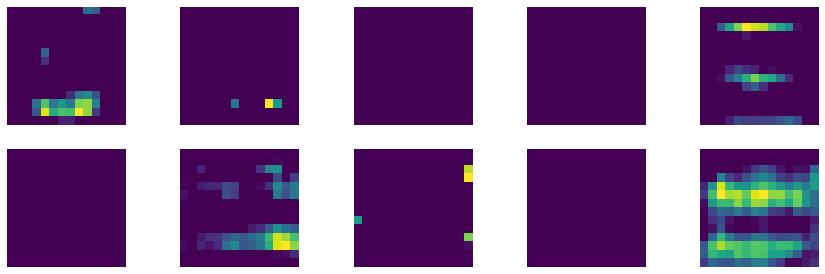

In [16]:
import cv2
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input, decode_predictions
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt

# Load the pre-trained VGG16 model
model = VGG16(weights='imagenet')

# Define a function to preprocess the image
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    return x

# Specify the image path
image_path = "C:\\Users\\santo\\Desktop\\python\\Caldrive.jpg"

# Load and preprocess the image
preprocessed_image = preprocess_image(image_path)

# Get the activations for the last convolutional layer
layer_name = 'block5_conv3'
activation_model = Model(inputs=model.input, outputs=model.get_layer(layer_name).output)
activations = activation_model.predict(preprocessed_image)

# Visualize the activations
plt.figure(figsize=(15, 10))
for i in range(10):  # Display the first 10 channels
    plt.subplot(4, 5, i + 1)
    plt.imshow(activations[0, :, :, i], cmap='viridis')
    plt.axis('off')
plt.show()


1/1 [==============================] - 0s 364ms/step


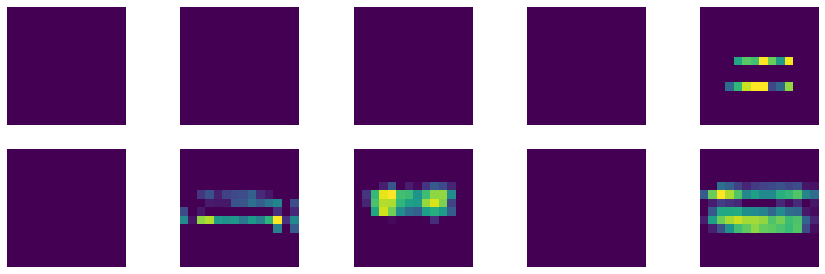

In [17]:
# Load the pre-trained VGG16 model
model = VGG16(weights='imagenet')

# Define a function to preprocess the image
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    return x

# Specify the image path
image_path ="C:\\Users\\santo\\Desktop\\python\\Cetrizine.webp"
# Load and preprocess the image
preprocessed_image = preprocess_image(image_path)

# Get the activations for the last convolutional layer
layer_name = 'block5_conv3'
activation_model = Model(inputs=model.input, outputs=model.get_layer(layer_name).output)
activations = activation_model.predict(preprocessed_image)

# Visualize the activations
plt.figure(figsize=(15, 10))
for i in range(10):  # Display the first 10 channels
    plt.subplot(4, 5, i + 1)
    plt.imshow(activations[0, :, :, i], cmap='viridis')
    plt.axis('off')
plt.show()

# Data Augmentation

In [20]:
import os
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from PIL import Image

# Define the directories

input_directory =   "C:\\Users\\santo\\Desktop\\python\\Finaldata1"
output_directory =  "C:\\Users\\santo\\Desktop\\python\\finaldaata"# Replace with your output directory
# Create output directory if it doesn't exist
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Initialize ImageDataGenerator for augmentation
datagen = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Iterate over the images in the input directory and apply data augmentation
for filename in os.listdir(input_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Check if the file is an image
        img = Image.open(os.path.join(input_directory, filename))
        x = np.array(img)
        x = np.expand_dims(x, axis=0)

        # Generate augmented images and save them to the output directory
        i = 0
        for batch in datagen.flow(x, batch_size=1):
            augmented_img = Image.fromarray(batch[0].astype('uint8'))
            augmented_filename = f'aug_{i}_{filename}'
            augmented_filepath = os.path.join(output_directory, augmented_filename)
            augmented_img.save(augmented_filepath)
            i += 1
            if i >= 4:  # Save 4 augmented images per original image
                break


# Algorithms Used for Medicine strip identification
# 1.ResNet50# 2.SCALE INVARIENT FEATURE TRANSFORM(SIFT)

ResNet-50, short for Residual Network with 50 layers, is a deep convolutional neural network architecture that was introduced by Microsoft Research in 2015. It's part of the ResNet family, which was designed to address the vanishing gradient problem in very deep neural networks.

Key features and components of ResNet-50:

Deep Architecture: ResNet-50 is a deep neural network with 50 layers. This depth is achieved through the use of residual learning blocks.

Residual Learning Blocks: The core idea of ResNet is the residual learning block, which allows the network to learn residual functions. Each block consists of shortcut connections that skip one or more layers, allowing the network to learn the residual mapping.

Shortcut Connections: These are shortcuts that skip one or more layers, allowing the network to pass the input information (identity) directly to deeper layers. This helps in bypassing vanishing gradient issues and facilitates the training of very deep networks.

Bottleneck Architecture: ResNet-50 uses a bottleneck architecture in its residual blocks. This involves using 1x1, 3x3, and 1x1 convolutions successively to reduce computational complexity while maintaining network expressiveness.

Global Average Pooling (GAP): Instead of using fully connected layers at the end of the network, ResNet-50 uses GAP to reduce the spatial dimensions to a single value per feature map. This reduces overfitting and parameters, and it has been found to be effective in practice.

Pretrained Weights: ResNet-50 is often pretrained on large datasets like ImageNet, which helps in transfer learning for various computer vision tasks.

Activation Function: Typically, ReLU (Rectified Linear Unit) is used as the activation function in the intermediate layers, promoting faster convergence during training.

ResNet-50, like other variations of the ResNet architecture, has been widely used in various computer vision tasks such as image classification, object detection, and segmentation. Its ability to handle very deep networks and its high accuracy make it a popular choice for a wide range of applications in the field of computer vision.





Regenerate


Image Loading and Preprocessing:

Load the images on which you want to apply the SIFT algorithm. Preprocess the images as needed, which may include resizing, converting to grayscale, or enhancing the image quality.
Key Point Detection:

Use the SIFT algorithm to detect key points (interest points) in the images. SIFT identifies distinctive regions in the image that can be used for further analysis.
Descriptor Generation:

For each key point, generate a descriptor. The descriptor provides a compact representation of the local image structure around the key point. Commonly used descriptors include histograms of gradient directions in a local neighborhood.
Matching Key Points:

Match key points between different images. This step involves comparing the descriptors of key points in one image with those in another image to find matching points.
Feature Matching:

Utilize the matched key points to align images or perform other tasks, such as object recognition or image stitching.

# RESNET-50 

1/1 [==============================] - 0s 134ms/step
Most similar image filename: 9da39145-8e32-41e4-b059-d855e81e0d5c.jpg
Similarity score: 0.7971337


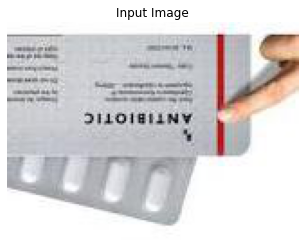

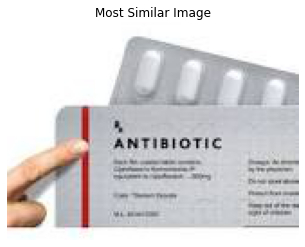

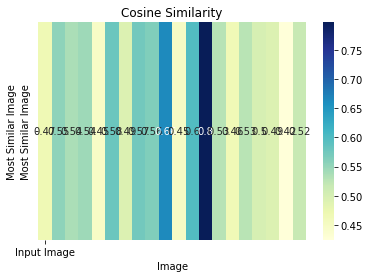

Best Accuracy: 1.0
Best Similarity Threshold: 0.8


In [4]:
import os
import numpy as np
import seaborn as sns
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing import image
from sklearn.metrics.pairwise import cosine_similarity
from PIL import Image

# Specify the directory where the images are stored
image_directory = r"C:\Users\santo\Desktop\python\images2021"

# Load the pre-trained ResNet50 model without the top classification layer
base_model = ResNet50(weights='imagenet', include_top=False, pooling='avg')

def extract_features(image_path):
    try:
        # Load and preprocess the image
        img = Image.open(image_path)
        img = img.resize((224, 224))  # Resize to match the input size for ResNet50
        img = image.img_to_array(img)
        img = np.expand_dims(img, axis=0)
        img = preprocess_input(img)

        # Extract features using the pre-trained ResNet50 model
        features = base_model.predict(img)
        return features.flatten()  # Flatten the features
    except Exception as e:
        print(f"Error processing image {image_path}: {str(e)}")
        return None

# List all image files in the specified directory
image_paths = [os.path.join(image_directory, filename) for filename in os.listdir(image_directory)]

# Extract features for all images
image_features = []
for img_path in image_paths:
    features = extract_features(img_path)
    if features is not None:
        image_features.append(features)

# Convert the list of features to a numpy array
image_features = np.array(image_features)

# Example: Calculate similarity for a new image
new_image_path ="C:\\Users\\santo\\Desktop\\python\\images12\\rotated_127b3117-651b-4c5c-918d-77fd7951726a.jpeg"# Replace with the correct path
try:
    new_features = extract_features(new_image_path)
    if new_features is not None:
        # Calculate similarity with the dataset
        similarities = cosine_similarity([new_features], image_features)

        # Find the most similar image
        most_similar_index = np.argmax(similarities)
        most_similar_image_filename = os.path.basename(image_paths[most_similar_index])

        print("Most similar image filename:", most_similar_image_filename)
        print("Similarity score:", similarities[0, most_similar_index])
        #Display the input image
        plt.figure()
        img = Image.open(new_image_path)
        plt.title('Input Image')
        plt.imshow(img)
        plt.axis('off')
        # Display the most similar image
        plt.figure()
        most_similar_img = Image.open(image_paths[most_similar_index])
        plt.title('Most Similar Image')
        plt.imshow(most_similar_img)
        plt.axis('off')
        plt.show()
        plt.figure()
        sns.heatmap(similarities, annot=True, cmap="YlGnBu", xticklabels=['Input Image'], yticklabels=['Most Similar Image'])
        plt.xlabel('Image')
        plt.ylabel('Most Similar Image')
        plt.title('Cosine Similarity')
        plt.show()

except PermissionError as pe:
    print(f"Permission denied: {str(pe)}")
def calculate_accuracy(similarities, actual_labels):
    best_threshold = 0.0
    best_accuracy = 0.0

    # Iterate over a range of thresholds and calculate accuracy for each
    for threshold in np.arange(0.1, 1.0, 0.1):
        predicted_labels = np.array(['similar' if similarity > threshold else 'not_similar' for similarity in similarities[0]])
        accuracy = np.mean(actual_labels == predicted_labels)

        if accuracy > best_accuracy:
            best_accuracy = accuracy
            best_threshold = threshold

    return best_accuracy, best_threshold

# Assuming the filenames follow a convention like "similar" or "not_similar"
actual_labels = np.array(['similar' if 'similar' in path else 'not_similar' for path in image_paths])

# Calculate accuracy and the best similarity threshold
best_accuracy, best_threshold = calculate_accuracy(similarities, actual_labels)

print("Best Accuracy:", best_accuracy)
print("Best Similarity Threshold:", best_threshold)




In [ ]:
#importebt111(executing properly)
import cv2
import os

# Specify the directory where the images are stored
image_directory = r"C:\Users\santo\Desktop\python\images2021"
new_image_path = r"C:\Users\santo\Desktop\python\hiii.jpg"  # Replace with the correct path

# Load the new image
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)

# Initialize SIFT detector
sift = cv2.SIFT_create()

# Find the keypoints and descriptors with SIFT
keypoints1, descriptors1 = sift.detectAndCompute(new_image, None)

# Initialize a Brute Force Matcher object
bf = cv2.BFMatcher()

# List to store similarity scores for each image
similarity_scores = []

# Iterate through the images in the directory
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_directory, filename)
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        # Compute keypoints and descriptors for the current image
        keypoints2, descriptors2 = sift.detectAndCompute(image, None)

        # Perform KNN matching using descriptors
        matches = bf.knnMatch(descriptors1, descriptors2, k=2)

        # Apply ratio test
        good_matches = []
        for m, n in matches:
            if m.distance < 0.75 * n.distance:
                good_matches.append(m)

        # Compute similarity score based on the number of good matches
        similarity_score = len(good_matches)
        similarity_scores.append((filename, similarity_score))

        # Draw matches between images
        img_matches = cv2.drawMatches(new_image, keypoints1, image, keypoints2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        cv2.imshow(f"Matches with {filename}", img_matches)

# Sort images by similarity score (higher score means higher similarity)
sorted_images = sorted(similarity_scores, key=lambda x: x[1], reverse=True)

# Display the sorted images and their similarity scores
for filename, similarity_score in sorted_images:
    print(f"Image: {filename}, Similarity Score: {similarity_score}")
most_similar_image_name = sorted_images[0][0]
print("Most Similar Image:", most_similar_image_name)


# Display the most similar image
most_similar_image_path = os.path.join(image_directory, sorted_images[0][0])
most_similar_image = cv2.imread(most_similar_image_path)
cv2.imshow("Most Similar Image", most_similar_image)

# Wait for any key press and close OpenCV windows
cv2.waitKey(0)
cv2.destroyAllWindows()

Image: 4c73d160-e9bc-4700-a090-44c70ccf504e.jpg, Similarity Score: 98
Image: 87d4eb22-3382-49ab-a408-5040d697c0c3.jpg, Similarity Score: 7
Image: b2dd7323-8c91-45ac-965a-1ba59e5bb936.jpg, Similarity Score: 6
Image: 14152835-cf73-4a32-97e4-5f888c1fa8a1.jpg, Similarity Score: 4
Image: 271fd1ca-897e-4116-b68d-d5bfcfc835a5.jpg, Similarity Score: 4
Image: 67734238-63ec-435a-a21a-89900844e54d.jpg, Similarity Score: 4
Image: c4f35595-487b-43ca-8864-bac2505b22ba.jpg, Similarity Score: 4
Image: d95b0dd1-e354-4ae0-961e-782dcdbf5c1a.jpg, Similarity Score: 4
Image: b8f992ce-efbf-4400-8345-2b09cf0ae340.jpg, Similarity Score: 3
Image: 20a0662f-bba8-4373-bca5-c709c174b87c.jpg, Similarity Score: 2
Image: 71f3963c-57d9-456e-a34b-553b93c66f67.jpg, Similarity Score: 2
Image: 9da39145-8e32-41e4-b059-d855e81e0d5c.jpg, Similarity Score: 2
Image: a105c2ac-393b-45ab-a597-9dc3200eca8b.jpg, Similarity Score: 2
Image: ae0faa6a-ff03-490e-b0cc-c1f26188f4f5.jpg, Similarity Score: 2
Image: f72d1b8f-2262-4d1e-b8c1-69

In [1]:
#Final best code 
import cv2
import os

# Function to compute SIFT keypoints and descriptors for an image
def compute_sift(image):
    if image is None:
        return None, None
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return keypoints, descriptors

# Load the new image
new_image_path = "C:\\Users\\santo\\Downloads\\debricloseup.png"
new_image = cv2.imread(new_image_path)

# Check if the image was loaded successfully
if new_image is None:
    print("Error: Unable to load the new image.")
    exit()

# Check if the image has the correct depth
if new_image.dtype != 'uint8':
    print("Error: Incorrect image depth. The image should have uint8 depth.")
    exit()

# Compute keypoints and descriptors for the new image
keypoints1, descriptors1 = compute_sift(new_image)

# Specify the directory where the images are stored
image_directory = r"C:\Users\santo\Desktop\python\finaldata1"

# Initialize a Brute Force Matcher object
bf = cv2.BFMatcher()

# List to store similarity scores for each image
similarity_scores = []

# Iterate through the images in the directory
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_directory, filename)
        image = cv2.imread(image_path)
        
        # Check if the image was loaded successfully
        if image is None:
            print(f"Error: Unable to load image '{filename}'.")
            continue

        # Check if the image has the correct depth
        if image.dtype != 'uint8':
            print(f"Error: Incorrect image depth for image '{filename}'. The image should have uint8 depth.")
            continue

        # Compute keypoints and descriptors for the current image
        keypoints2, descriptors2 = compute_sift(image)

        # Perform KNN matching using descriptors
        matches = bf.knnMatch(descriptors1, descriptors2, k=2)

        # Apply ratio test
        good_matches = []
        for m, n in matches:
            if m.distance < 0.75 * n.distance:
                good_matches.append(m)

        # Compute similarity score based on the number of good matches
        similarity_score = len(good_matches)
        similarity_scores.append((filename, similarity_score, good_matches))

# Sort images by similarity score (higher score means higher similarity)
sorted_images = sorted(similarity_scores, key=lambda x: x[1], reverse=True)

# Display keypoints on the new image
img_with_keypoints = cv2.drawKeypoints(new_image, keypoints1, None)
cv2.imshow("Keypoints on New Image", img_with_keypoints)

# Display the best matched image
if sorted_images:
    best_matched_image_path = os.path.join(image_directory, sorted_images[0][0])
    best_matched_image = cv2.imread(best_matched_image_path)
    cv2.imshow("Best Matched Image", best_matched_image)
    print(f"\nBest Matched Image: {sorted_images[0][0]}")
    print(f"Similarity Score: {sorted_images[0][1]}")
else:
    print("No images found for matching.")

# Display the matches with the top matched image
if sorted_images:
    selected_image_path = os.path.join(image_directory, sorted_images[0][0])
    selected_image = cv2.imread(selected_image_path)

    # Compute keypoints and descriptors for the selected image
    keypoints2, descriptors2 = compute_sift(selected_image)

    # Draw the matches only if keypoints are detected
    if keypoints2:
        img_matches = cv2.drawMatches(
            new_image, keypoints1, selected_image, keypoints2, good_matches, None,
            flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        cv2.imshow(f"Matches with {sorted_images[0][0]}", img_matches)
        print(f"\nMatches with {sorted_images[0][0]}")
        print(f"Similarity Score: {sorted_images[0][1]}")
    else:
        print(f"No keypoints detected in the selected image: {sorted_images[0][0]}")
# Close OpenCV windows
cv2.waitKey(0)
cv2.destroyAllWindows()


Best Matched Image: Debrilyse.png
Similarity Score: 110

Matches with Debrilyse.png
Similarity Score: 110


# SIFT

In [2]:
#Final best code 
import cv2
import os
from gtts import gTTS
def resize_image(image, width=None, height=None):
    """
    Resize the input image to the specified width and/or height.
    If width or height is None, it will be calculated maintaining the aspect ratio.

    Parameters:
        image (numpy.ndarray): The input image.
        width (int or None): The desired width of the output image.
        height (int or None): The desired height of the output image.

    Returns:
        numpy.ndarray: The resized image.
    """
    if width is None and height is None:
        return image

    aspect_ratio = image.shape[1] / image.shape[0]

    if width is None:
        width = int(height * aspect_ratio)
    elif height is None:
        height = int(width / aspect_ratio)

    resized_image = cv2.resize(image, (width, height))
    return resized_image

def text_to_speech(text, output_path='output.mp3', lang='en'):
    """
    Convert the given text to speech and save it as an MP3 file.

    Parameters:
        text (str): The text to be converted to speech.
        output_path (str): Path to save the MP3 file.
        lang (str): Language code (e.g., 'en' for English).
    """
    tts = gTTS(text=text, lang=lang, slow=False)
    tts.save(output_path)
    print(f'Saved the speech to {output_path}')
# Function to compute SIFT keypoints and descriptors for an image
def compute_sift(image):
    if image is None:
        return None, None
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return keypoints, descriptors

# Load the new image
new_image_path ="C:\\Users\\santo\\Desktop\\python\\testrotated1.png"
new_image = cv2.imread(new_image_path)

# Check if the image was loaded successfully
if new_image is None:
    print("Error: Unable to load the new image.")
    exit()

# Check if the image has the correct depth
if new_image.dtype != 'uint8':
    print("Error: Incorrect image depth. The image should have uint8 depth.")
    exit()

# Compute keypoints and descriptors for the new image
keypoints1, descriptors1 = compute_sift(new_image)

# Specify the directory where the images are stored
image_directory = r"C:\Users\santo\Desktop\python\finaldata1"

# Initialize a Brute Force Matcher object
bf = cv2.BFMatcher()

# List to store similarity scores for each image
similarity_scores = []

# Iterate through the images in the directory
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_directory, filename)
        image = cv2.imread(image_path)
        
        # Check if the image was loaded successfully
        if image is None:
            print(f"Error: Unable to load image '{filename}'.")
            continue

        # Check if the image has the correct depth
        if image.dtype != 'uint8':
            print(f"Error: Incorrect image depth for image '{filename}'. The image should have uint8 depth.")
            continue

        # Compute keypoints and descriptors for the current image
        keypoints2, descriptors2 = compute_sift(image)

        # Perform KNN matching using descriptors
        matches = bf.knnMatch(descriptors1, descriptors2, k=2)

        # Apply ratio test
        good_matches = []
        for m, n in matches:
            if m.distance < 0.75 * n.distance:
                good_matches.append(m)

        # Compute similarity score based on the number of good matches
        similarity_score = len(good_matches)
        similarity_scores.append((filename, similarity_score, good_matches))

# Sort images by similarity score (higher score means higher similarity)
sorted_images = sorted(similarity_scores, key=lambda x: x[1], reverse=True)

# Display keypoints on the new image
img_with_keypoints = cv2.drawKeypoints(new_image, keypoints1, None)
img_with_keypoints_resized = resize_image(img_with_keypoints, width=400, height=None)
cv2.imshow("Keypoints on New Image", img_with_keypoints_resized)

# Display the best matched image
if sorted_images:
    best_matched_image_path = os.path.join(image_directory, sorted_images[0][0])
    best_matched_image = cv2.imread(best_matched_image_path)
    best_matched_image_resized = resize_image(best_matched_image, width=800, height=None)
    cv2.imshow("Best Matched Image", best_matched_image_resized)
    print(f"\nBest Matched Image: {sorted_images[0][0]}")
    print(f"Similarity Score: {sorted_images[0][1]}")
else:
    print("No images found for matching.")
if __name__ == "__main__":
    text = sorted_images[0][0]
    output_file = "output123.mp3"
    text_to_speech(text, output_file)
# Display the matches with the top matched image
# ... Rest of your code ...

# Display the matches with the top matched image
if sorted_images:
    selected_image_path = os.path.join(image_directory, sorted_images[0][0])
    selected_image = cv2.imread(selected_image_path)
    selected_image_resized = resize_image(selected_image, width=800, height=None)
    
    # Compute keypoints and descriptors for the selected image
    keypoints2, descriptors2 = compute_sift(selected_image)

    # Draw the matches only if keypoints are detected
    if keypoints2:
        img_matches = cv2.drawMatches(
            new_image, keypoints1, selected_image_resized, keypoints2, good_matches, None,
            flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        # Resize the matched image for display
        img_matches_resized = resize_image(img_matches, width=800, height=None)
        cv2.imshow(f"Matches with {sorted_images[0][0]}", img_matches_resized)
        print(f"\nMatches with {sorted_images[0][0]}")
        print(f"Similarity Score: {sorted_images[0][1]}")
    else:
        print(f"No keypoints detected in the selected image: {sorted_images[0][0]}")
# ... Rest of your code ...
# Close OpenCV windows
cv2.waitKey(0)
cv2.destroyAllWindows()  


Best Matched Image: Prizide.png
Similarity Score: 12492
Saved the speech to output123.mp3

Matches with Prizide.png
Similarity Score: 12492


# SIFT KEY POINTS EXTRACTION

In [ ]:
import cv2
import os

# Function to compute SIFT keypoints and descriptors for an image
def compute_sift(image):
    if image is None:
        return None, None
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return keypoints, descriptors

# Load the new image
new_image_path = "C:\\Users\\santo\\Desktop\\python\\test123.png"
new_image = cv2.imread(new_image_path)

# Check if the image was loaded successfully
if new_image is None:
    print("Error: Unable to load the new image.")
    exit()

# Check if the image has the correct depth
if new_image.dtype != 'uint8':
    print("Error: Incorrect image depth. The image should have uint8 depth.")
    exit()

# Compute keypoints and descriptors for the new image
keypoints1, descriptors1 = compute_sift(new_image)

# Specify the directory where the images are stored
image_directory = r"C:\Users\santo\Desktop\python\finaldata1"

# Initialize a Brute Force Matcher object
bf = cv2.BFMatcher()

# List to store similarity scores for each image
similarity_scores = []

# Iterate through the images in the directory
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_directory, filename)
        image = cv2.imread(image_path)
        
        # Check if the image was loaded successfully
        if image is None:
            print(f"Error: Unable to load image '{filename}'.")
            continue

        # Check if the image has the correct depth
        if image.dtype != 'uint8':
            print(f"Error: Incorrect image depth for image '{filename}'. The image should have uint8 depth.")
            continue

        # Compute keypoints and descriptors for the current image
        keypoints2, descriptors2 = compute_sift(image)

        # Perform KNN matching using descriptors
        matches = bf.knnMatch(descriptors1, descriptors2, k=2)

        # Apply ratio test
        good_matches = []
        for m, n in matches:
            if m.distance < 0.75 * n.distance:
                good_matches.append(m)

        # Compute similarity score based on the number of good matches
        similarity_score = len(good_matches)
        similarity_scores.append((filename, similarity_score, good_matches))

# Sort images by similarity score (higher score means higher similarity)
sorted_images = sorted(similarity_scores, key=lambda x: x[1], reverse=True)

# Display keypoints on the new image
img_with_keypoints = cv2.drawKeypoints(new_image, keypoints1, None)
cv2.imshow("Keypoints on New Image", img_with_keypoints)

# Display the best matched image
if sorted_images:
    best_matched_image_path = os.path.join(image_directory, sorted_images[0][0])
    best_matched_image = cv2.imread(best_matched_image_path)
    cv2.imshow("Best Matched Image", best_matched_image)
    print(f"\nBest Matched Image: {sorted_images[0][0]}")
    print(f"Similarity Score: {sorted_images[0][1]}")
else:
    print("No images found for matching.")

# Display the matches with the top matched image
if sorted_images:
    selected_image_path = os.path.join(image_directory, sorted_images[0][0])
    selected_image = cv2.imread(selected_image_path)
    _, selected_descriptors = compute_sift(selected_image)
    matches = bf.knnMatch(descriptors1, selected_descriptors, k=2)

    # Apply ratio test
    good_matches = []
    for m, n in matches:
        if m.distance < 0.75 * n.distance:
            good_matches.append(m)
    # Draw the matches
    # Draw the matches
    # Draw the matches only if keypoints are detected
    # Draw the matches only if keypoints are detected
    if keypoints2:
    # Print the keypoints and descriptors
        print("Keypoints and Descriptors for the selected image:")
        for i, keypoint in enumerate(keypoints2):
            print(f"Keypoint {i+1}:")
            print(f"  - Position: ({keypoint.pt[0]}, {keypoint.pt[1]})")
            print(f"  - Size: {keypoint.size}")
            print(f"  - Angle: {keypoint.angle}")
            print(f"  - Response: {keypoint.response}")
            print(f"  - Octave: {keypoint.octave}")
            print(f"  - Class ID: {keypoint.class_id}")
            print(f"  - Descriptor: {descriptors2[i]}")

    # Draw the matches
        img_matches = cv2.drawMatches(
        new_image, keypoints1, selected_image, keypoints2, good_matches, None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    # Display the matches
        cv2.imshow(f"Matches with {sorted_images[choice - 1][0]}", img_matches)
        print(f"\nMatches with {sorted_images[choice - 1][0]}")
        print(f"Similarity Score: {sorted_images[choice - 1][1]}")
    else:
        print(f"No keypoints detected in the selected image: {sorted_images[choice - 1][0]}")
        
# Close OpenCV windows
cv2.waitKey(0)
cv2.destroyAllWindows()


Best Matched Image: Prizide.png
Similarity Score: 20701
Keypoints and Descriptors for the selected image:
Keypoint 1:
  - Position: (9.959962844848633, 757.14892578125)
  - Size: 2.1147096157073975
  - Angle: 0.366546630859375
  - Response: 0.021654687821865082
  - Octave: 11796991
  - Class ID: -1
  - Descriptor: [ 41.   0.   0.   0.   0.   0.   0.   0. 183.  12.   0.   4.  13.   2.
   0.   3.  51.   5.   0.  15. 147.  10.   0.   2.  19.   0.   0.   0.
  21.   3.   1.  13.  51.   0.   0.   0.   0.   0.   0.   0. 183.   6.
   0.   2.  15.   4.   0.   9.  67.   2.   0.   7. 164.  27.   0.   6.
  32.   2.   0.   0.  21.   4.   1.  22.  51.   0.   0.   0.   0.   0.
   0.   0. 183.   1.   0.   1.  16.   2.   0.   6.  75.   0.   0.   2.
 169.  28.   0.   4.  38.  10.   0.   0.  20.  13.   2.   5.  41.   0.
   0.   0.   0.   0.   0.   0. 183.   0.   0.   0.  10.   4.   0.   9.
  62.   0.   0.   0. 119.  36.   0.   5.  16.   9.   1.   2.  28.  15.
   1.   1.]
Keypoint 2:
  - Position: (10.01

In [ ]:
#importebt111(executing properly)
import cv2
import os

# Specify the directory where the images are stored
image_directory = "C:\\Users\\santo\\Desktop\\python\\finaldata1"
new_image_path =  "C:\\Users\\santo\\Downloads\\debricloseup.png"  # Replace with the correct path

# Load the new image
new_image = cv2.imread(new_image_path, cv2.IMREAD_GRAYSCALE)

# Initialize SIFT detector
sift = cv2.SIFT_create()

# Find the keypoints and descriptors with SIFT
keypoints1, descriptors1 = sift.detectAndCompute(new_image, None)

# Initialize a Brute Force Matcher object
bf = cv2.BFMatcher()

# List to store similarity scores for each image
similarity_scores = []

# Iterate through the images in the directory
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_directory, filename)
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

        # Compute keypoints and descriptors for the current image
        keypoints2, descriptors2 = sift.detectAndCompute(image, None)

        # Perform KNN matching using descriptors
        matches = bf.knnMatch(descriptors1, descriptors2, k=2)

        # Apply ratio test
        good_matches = []
        for m, n in matches:
            if m.distance < 0.75 * n.distance:
                good_matches.append(m)

        # Compute similarity score based on the number of good matches
        similarity_score = len(good_matches)
        similarity_scores.append((filename, similarity_score))

        # Draw matches between images
        img_matches = cv2.drawMatches(new_image, keypoints1, image, keypoints2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        cv2.imshow(f"Matches with {filename}", img_matches)

# Sort images by similarity score (higher score means higher similarity)
sorted_images = sorted(similarity_scores, key=lambda x: x[1], reverse=True)

# Display the sorted images and their similarity scores
for filename, similarity_score in sorted_images:
    print(f"Image: {filename}, Similarity Score: {similarity_score}")
most_similar_image_name = sorted_images[0][0]
print("Most Similar Image:", most_similar_image_name)


# Display the most similar image
most_similar_image_path = os.path.join(image_directory, sorted_images[0][0])
most_similar_image = cv2.imread(most_similar_image_path)
cv2.imshow("Most Similar Image", most_similar_image)

# Wait for any key press and close OpenCV windows
cv2.waitKey(0)
cv2.destroyAllWindows()

Image: Debrilyse.png, Similarity Score: 103
Image: Onitaz-Forte.png, Similarity Score: 2
Image: Beta-Nicardia.png, Similarity Score: 1
Image: Caldrive.png, Similarity Score: 1
Image: Coldact.png, Similarity Score: 1
Image: Evidox.png, Similarity Score: 1
Image: Monosprin.png, Similarity Score: 1
Image: Naprosyn.png, Similarity Score: 1
Image: Nexonerve.png, Similarity Score: 1
Image: Calcijoint.png, Similarity Score: 0
Image: Citrizine.png, Similarity Score: 0
Image: Deemol.png, Similarity Score: 0
Image: Dolamide.png, Similarity Score: 0
Image: Lovax.png, Similarity Score: 0
Image: Palozac.png, Similarity Score: 0
Image: Paracetamol.png, Similarity Score: 0
Image: Prizide.png, Similarity Score: 0
Image: Texof.png, Similarity Score: 0
Image: Trental.png, Similarity Score: 0
Image: Tricium-plus.png, Similarity Score: 0
Most Similar Image: Debrilyse.png


In [4]:
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
import os

#

def extract_sift_features(image_path):
    try:
        # Load the image
        image = cv2.imread(image_path)

        # Check if the image was loaded successfully
        if image is None:
            raise ValueError(f"Unable to load image from {image_path}")

        # Downsample the image to a smaller size
        image = cv2.resize(image, (0, 0), fx=0.5, fy=0.5)

        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sift = cv2.SIFT_create(nfeatures=128)  # Set nfeatures to 128

        keypoints, descriptors = sift.detectAndCompute(gray_image, None)
        return descriptors

    except Exception as e:
        print(f"Error processing image {image_path}: {str(e)}")
        return None


# Specify the images directory
images_directory ="C:\\Users\\santo\\Desktop\\python\\finaldata1"
# Load images, extract SIFT features, and prepare features and labels
features = []
labels = []
# Loop through the image files
for file in os.listdir(images_directory):
    image_path = os.path.join(images_directory, file)
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Use the image name (excluding extension) as the label
        label = os.path.splitext(file)[0]
        features.extend(descriptors)
        labels.extend([label] * len(descriptors))
# Convert features and labels to numpy arrays
features = np.array(features)
labels = np.array(labels)
# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)
# Train a machine learning model (SVM in this example)
model = SVC()
model.fit(X_train, y_train)
# Predict label for a new image
def predict_label_for_new_image(image_path):
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Predict the label for the new image
        predicted_label = model.predict(descriptors)
        return predicted_label[0]
    else:
        print("No features were extracted for the new image.")
        return None
# Example usage: Predict label for a new image
new_image_path =  r"C:\\Users\\santo\\Desktop\\python\\svmtest.png"# Replace with the path to your new image
predicted_label = predict_label_for_new_image(new_image_path)
if predicted_label is not None:
    print("Predicted label for the new image:", predicted_label)
    # Load and display the input image
    input_image = cv2.imread(new_image_path)
    cv2.imshow('Input Image', input_image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()
    # Load and display the image corresponding to the predicted label
    predicted_image_path = os.path.join(images_directory, predicted_label + '.png')
    if os.path.exists(predicted_image_path):
        predicted_image = cv2.imread(predicted_image_path)
        cv2.imshow('Predicted Image', predicted_image)
        cv2.waitKey(0)
        cv2.destroyAllWindows()
    else:
        print('Predicted image not found.')


Predicted label for the new image: Caldrive


In [7]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from shutil import copyfile
# ... Rest of the code for SIFT feature extraction, train-test split, and model training ...
 #Function to extract SIFT features from images
import cv2

def extract_sift_features(image_path):
    try:
        # Load the image using OpenCV
        image = cv2.imread(image_path)
        
        # Check if the image was loaded successfully
        if image is None:
            print(f"Error: Unable to load image from path {image_path}")
            return None, None

        # Downsample the image to a smaller size
        image = cv2.resize(image, (0, 0), fx=0.5, fy=0.5)
        
        # Convert the image to grayscale
        gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        
        # Initialize SIFT detector
        sift = cv2.SIFT_create()
        
        # Detect keypoints and descriptors
        keypoints, descriptors = sift.detectAndCompute(gray_image, None)
        
        return keypoints, descriptors
    
    except Exception as e:
        print(f"An error occurred during feature extraction: {str(e)}")
        return None, None

# Specify the images directory
images_directory = r"C:\\Users\\santo\\Desktop\\python\\acc"

# Load images, extract SIFT features, and prepare features and labels
features = []
labels = []
# Extract SIFT features for all images and store descriptors
descriptors_list = []
labels_list = []
# Loop through the image files
for file in os.listdir(images_directory):
    image_path = os.path.join(images_directory, file)
    keypoints, descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Handle missing values (NaN) in descriptors
        descriptors = descriptors[~np.isnan(descriptors).any(axis=1)]
        
        # Append descriptors and corresponding labels
        descriptors_list.extend(descriptors)
        label = os.path.splitext(file)[0]
        labels_list.extend([label] * len(descriptors))

# Convert features and labels to numpy arrays
descriptors_array = np.array(descriptors_list)
labels_array = np.array(labels_list)

print("Number of descriptors:", descriptors_array.shape[0])
print("Number of labels:", labels_array.shape[0])
# ... Rest of the code ...

# Print the shapes of descriptors and labels arrays
print("Shape of descriptors array:", descriptors_array.shape)
print("Shape of labels array:", labels_array.shape)

# Print some file paths to check if they are correct
print("Example file paths:")
for file_path in os.listdir(images_directory):
    print(os.path.join(images_directory, file_path))

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(descriptors_array, labels_array, test_size=0.2, random_state=42)

# ... Rest of the code ...


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(descriptors_array, labels_array, test_size=0.2, random_state=42)

# Check if the split was successful
if X_train.size == 0 or X_test.size == 0 or y_train.size == 0 or y_test.size == 0:
    print("Error: Train or test split resulted in empty sets. Check the data.")
    exit()

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(descriptors_array, labels_array, test_size=0.2, random_state=42)

# Check if the split was successful
if X_train.size == 0 or X_test.size == 0 or y_train.size == 0 or y_test.size == 0:
    print("Error: Train or test split resulted in empty sets. Check the data.")
    exit()
model = SVC()
model.fit(X_train, y_train)

# Predict labels for the test set
predictions = model.predict(X_test)

# Evaluate the model (you can use classification metrics)
accuracy = np.mean(predictions == y_test)
print("Test Accuracy:", accuracy)
# ... Rest of the code ...

# Create directories to save images
train_images_directory = "train_images1"
test_images_directory = "test_images1"

# Check if the directories exist, if not, create them
if not os.path.exists(train_images_directory):
    os.makedirs(train_images_directory)

if not os.path.exists(test_images_directory):
    os.makedirs(test_images_directory)


# ... Previous code ...
# ... Previous code ...

# Define X_train_image_paths and X_test_image_paths
X_train_image_paths = [os.path.join(images_directory, file) for file in os.listdir(images_directory)]
X_test_image_paths = X_train_image_paths  # Modify this based on your actual test set

# ... Rest of the code ...

# Save training images
save_images(X_train, y_train, train_images_directory, X_train_image_paths)
# Save testing images
save_images(X_test, y_test, test_images_directory, X_test_image_paths)

print("Training images saved to:", os.path.abspath(train_images_directory))
print("Testing images saved to:", os.path.abspath(test_images_directory))







Number of descriptors: 1315
Number of labels: 1315
Shape of descriptors array: (1315, 128)
Shape of labels array: (1315,)
Example file paths:
C:\\Users\\santo\\Desktop\\python\\acc\Beta-Nicardia.png
C:\\Users\\santo\\Desktop\\python\\acc\Calcijoint.png
C:\\Users\\santo\\Desktop\\python\\acc\Caldrive.png
C:\\Users\\santo\\Desktop\\python\\acc\Citrizine.png
C:\\Users\\santo\\Desktop\\python\\acc\Coldact.png
C:\\Users\\santo\\Desktop\\python\\acc\Debrilyse.png
C:\\Users\\santo\\Desktop\\python\\acc\Deemol.png
C:\\Users\\santo\\Desktop\\python\\acc\Dolamide.png
C:\\Users\\santo\\Desktop\\python\\acc\Evidox.png
C:\\Users\\santo\\Desktop\\python\\acc\Lovax.png
C:\\Users\\santo\\Desktop\\python\\acc\Monosprin.png
C:\\Users\\santo\\Desktop\\python\\acc\Naprosyn.png
C:\\Users\\santo\\Desktop\\python\\acc\Nexonerve.png
C:\\Users\\santo\\Desktop\\python\\acc\Onitaz-Forte.png
C:\\Users\\santo\\Desktop\\python\\acc\Palozac.png
C:\\Users\\santo\\Desktop\\python\\acc\Paracetamol.png
C:\\Users\\santo\

In [1]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from shutil import copyfile
# ... Rest of the code for SIFT feature extraction, train-test split, and model training ...
 #Function to extract SIFT features from images
def extract_sift_features(image_path):
    image = cv2.imread(image_path)
    # Downsample the image to a smaller size
    image = cv2.resize(image, (0, 0), fx=0.5, fy=0.5)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return descriptors
# Specify the images directory
images_directory = r"C:\\Users\\santo\\Desktop\\python\\acc"
# Load images, extract SIFT features, and prepare features and labels
features = []
labels = []
# Loop through the image files
for file in os.listdir(images_directory):
    image_path = os.path.join(images_directory, file)
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Use the image name (excluding extension) as the label
        label = os.path.splitext(file)[0]
        features.extend(descriptors)
        labels.extend([label] * len(descriptors))
# Convert features and labels to numpy arrays
features = np.array(features)
labels = np.array(labels)
# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

# Train a machine learning model (SVM in this example)
model = SVC()
model.fit(X_train, y_train)

# Predict labels for the test set
predictions = model.predict(X_test)

# Evaluate the model (you can use classification metrics)
accuracy = np.mean(predictions == y_test)
print("Test Accuracy:", accuracy)
# ... Rest of the code ...

# Create directories to save images
train_images_directory = "train_images11"
test_images_directory = "test_images22"

# Check if the directories exist, if not, create them
if not os.path.exists(train_images_directory):
    os.makedirs(train_images_directory)
if not os.path.exists(test_images_directory):
    os.makedirs(test_images_directory)
def save_images(images, labels, destination_directory):
    for i, image in enumerate(images):
        # Get the label for this image
        label = labels[i]
        # Create the destination path
        destination_path = os.path.join(destination_directory, f"{label}_{i}.jpg")
        # Save the image
        cv2.imwrite(destination_path, image)

# Save training images
save_images(X_train, y_train, train_images_directory)
# Save testing images
save_images(X_test, y_test, test_images_directory)

print("Training images saved to:", os.path.abspath(train_images_directory))
print("Testing images saved to:", os.path.abspath(test_images_directory))

Test Accuracy: 0.39543726235741444
Training images saved to: C:\Users\santo\Desktop\python\train_images11
Testing images saved to: C:\Users\santo\Desktop\python\test_images22


# new implemenatation

In [25]:
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.models import Model
import numpy as np
import os

# Replace these with the actual dimensions of your images
height = 224
width = 224
channels = 3  # Assuming RGB images

# Load the pre-trained VGG16 model (you can replace this with other pre-trained models)
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(height, width, channels))

# Extract features using the pre-trained model
def extract_features(img_path):
    img = image.load_img(img_path, target_size=(height, width))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    features = base_model.predict(x)
    return features.flatten()

# Specify the directory where the images are stored
image_directory = r"C:\Users\santo\Desktop\python\finaldata1"
# Load features for each image in the dataset
dataset_features = {}
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_directory, filename)
        features = extract_features(image_path)
        dataset_features[filename] = features

# Load the new image for similarity comparison
new_image_path = r"C:\\Users\\santo\\Desktop\\python\\testrotated1.png"
new_image_features = extract_features(new_image_path)

# Calculate similarity scores and find the most similar image
similarity_scores = {}
for filename, features in dataset_features.items():
    similarity_scores[filename] = np.dot(new_image_features, features)

# Find the most similar image
most_similar_image = max(similarity_scores, key=similarity_scores.get)
similarity_score = similarity_scores[most_similar_image]

print(f"Most Similar Image: {most_similar_image}")
print(f"Similarity Score: {similarity_score}")


1/1 [==============================] - 0s 369ms/step
Most Similar Image: Prizide.png
Similarity Score: 1821826.5


In [27]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import to_categorical

# ... Rest of the code for SIFT feature extraction, train-test split, and data preparation ...
def extract_sift_features(image_path):
    image = cv2.imread(image_path)
    # Downsample the image to a smaller size
    image = cv2.resize(image, (0, 0), fx=0.5, fy=0.5)
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return descriptors
# Specify the images directory
images_directory = r"C:\\Users\\santo\\Desktop\\python\\finaldata2"

# Load images, extract SIFT features, and prepare features and labels
features = []
labels = []

# Loop through the image files
for file in os.listdir(images_directory):
    image_path = os.path.join(images_directory, file)
    descriptors = extract_sift_features(image_path)
    if descriptors is not None:
        # Use the image name (excluding extension) as the label
        label = os.path.splitext(file)[0]
        features.extend(descriptors)
        labels.extend([label] * len(descriptors))

# Convert features and labels to numpy arrays
features = np.array(features)
labels = np.array(labels)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42)

# Encode labels to numerical values
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

# Convert labels to one-hot encoding
y_train_onehot = to_categorical(y_train_encoded)
y_test_onehot = to_categorical(y_test_encoded)


model = Sequential()
model.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(len(label_encoder.classes_), activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train_onehot, epochs=10, batch_size=32, validation_data=(X_test, y_test_onehot))

# Evaluate the model on the test set
predictions_onehot = model.predict(X_test)
predictions_encoded = np.argmax(predictions_onehot, axis=1)
accuracy = accuracy_score(y_test_encoded, predictions_encoded)

print("Test Accuracy:", accuracy)


Epoch 1/10
515/515 [==============================] - 4s 5ms/step - loss: 8.9095 - accuracy: 0.1207 - val_loss: 2.9536 - val_accuracy: 0.1651
Epoch 2/10
515/515 [==============================] - 2s 5ms/step - loss: 2.8573 - accuracy: 0.1655 - val_loss: 2.8216 - val_accuracy: 0.1758
Epoch 3/10
515/515 [==============================] - 2s 5ms/step - loss: 2.7473 - accuracy: 0.1760 - val_loss: 2.7746 - val_accuracy: 0.1809
Epoch 4/10
515/515 [==============================] - 3s 5ms/step - loss: 2.6788 - accuracy: 0.1811 - val_loss: 2.7338 - val_accuracy: 0.1838
Epoch 5/10
515/515 [==============================] - 2s 5ms/step - loss: 2.6266 - accuracy: 0.1899 - val_loss: 2.6903 - val_accuracy: 0.1896
Epoch 6/10
515/515 [==============================] - 2s 5ms/step - loss: 2.5821 - accuracy: 0.1983 - val_loss: 2.6672 - val_accuracy: 0.1957
Epoch 7/10
515/515 [==============================] - 2s 5ms/step - loss: 2.5432 - accuracy: 0.2030 - val_loss: 2.6447 - val_accuracy: 0.2017
Epoch 

In [28]:
from tensorflow.keras.layers import Dropout

# Create a more complex feedforward neural network (MLP) model
model = Sequential()
model.add(Dense(256, input_dim=X_train.shape[1], activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(len(label_encoder.classes_), activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train_onehot, epochs=20, batch_size=32, validation_data=(X_test, y_test_onehot))

# Evaluate the model on the test set
predictions_onehot = model.predict(X_test)
predictions_encoded = np.argmax(predictions_onehot, axis=1)
accuracy = accuracy_score(y_test_encoded, predictions_encoded)

print("Test Accuracy:", accuracy)


Epoch 1/20
515/515 [==============================] - 6s 9ms/step - loss: 7.9864 - accuracy: 0.1295 - val_loss: 2.8702 - val_accuracy: 0.1680
Epoch 2/20
515/515 [==============================] - 4s 8ms/step - loss: 2.8631 - accuracy: 0.1556 - val_loss: 2.8048 - val_accuracy: 0.1680
Epoch 3/20
515/515 [==============================] - 4s 8ms/step - loss: 2.8013 - accuracy: 0.1567 - val_loss: 2.7783 - val_accuracy: 0.1680
Epoch 4/20
515/515 [==============================] - 4s 8ms/step - loss: 2.7764 - accuracy: 0.1568 - val_loss: 2.7682 - val_accuracy: 0.1680
Epoch 5/20
515/515 [==============================] - 4s 8ms/step - loss: 2.7654 - accuracy: 0.1570 - val_loss: 2.7643 - val_accuracy: 0.1680
Epoch 6/20
515/515 [==============================] - 4s 8ms/step - loss: 2.7621 - accuracy: 0.1570 - val_loss: 2.7628 - val_accuracy: 0.1680
Epoch 7/20
515/515 [==============================] - 4s 8ms/step - loss: 2.7621 - accuracy: 0.1570 - val_loss: 2.7624 - val_accuracy: 0.1680
Epoch 

In [29]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization

# Create a more complex feedforward neural network (MLP) model
model = Sequential()
model.add(Dense(512, input_dim=X_train.shape[1], activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(256, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(len(label_encoder.classes_), activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train_onehot, epochs=20, batch_size=32, validation_data=(X_test, y_test_onehot))

# Evaluate the model on the test set
predictions_onehot = model.predict(X_test)
predictions_encoded = np.argmax(predictions_onehot, axis=1)
accuracy = accuracy_score(y_test_encoded, predictions_encoded)

print("Test Accuracy:", accuracy)


Epoch 1/20
515/515 [==============================] - 10s 13ms/step - loss: 3.2805 - accuracy: 0.1344 - val_loss: 2.4928 - val_accuracy: 0.2217
Epoch 2/20
515/515 [==============================] - 6s 11ms/step - loss: 2.6530 - accuracy: 0.1911 - val_loss: 2.3976 - val_accuracy: 0.2508
Epoch 3/20
515/515 [==============================] - 6s 12ms/step - loss: 2.5139 - accuracy: 0.2136 - val_loss: 2.3601 - val_accuracy: 0.2573
Epoch 4/20
515/515 [==============================] - 6s 12ms/step - loss: 2.4399 - accuracy: 0.2268 - val_loss: 2.3312 - val_accuracy: 0.2683
Epoch 5/20
515/515 [==============================] - 6s 12ms/step - loss: 2.3993 - accuracy: 0.2400 - val_loss: 2.3070 - val_accuracy: 0.2773
Epoch 6/20
515/515 [==============================] - 6s 12ms/step - loss: 2.3785 - accuracy: 0.2461 - val_loss: 2.3006 - val_accuracy: 0.2753
Epoch 7/20
515/515 [==============================] - 6s 12ms/step - loss: 2.3486 - accuracy: 0.2525 - val_loss: 2.2718 - val_accuracy: 0.278

In [30]:
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler

# Define early stopping and learning rate scheduler callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

def lr_schedule(epoch):
    if epoch < 10:
        return 0.001
    elif epoch < 15:
        return 0.0001
    else:
        return 0.00001

lr_scheduler = LearningRateScheduler(lr_schedule)

# Train the model with callbacks
model.fit(X_train, y_train_onehot, epochs=20, batch_size=32, validation_data=(X_test, y_test_onehot), callbacks=[early_stopping, lr_scheduler])


Epoch 1/20
515/515 [==============================] - 6s 12ms/step - loss: 2.1866 - accuracy: 0.2949 - val_loss: 2.1708 - val_accuracy: 0.3098 - lr: 0.0010
Epoch 2/20
515/515 [==============================] - 6s 12ms/step - loss: 2.1696 - accuracy: 0.2996 - val_loss: 2.1625 - val_accuracy: 0.3190 - lr: 0.0010
Epoch 3/20
515/515 [==============================] - 6s 12ms/step - loss: 2.1684 - accuracy: 0.3020 - val_loss: 2.1595 - val_accuracy: 0.3193 - lr: 0.0010
Epoch 4/20
515/515 [==============================] - 6s 12ms/step - loss: 2.1679 - accuracy: 0.2989 - val_loss: 2.1518 - val_accuracy: 0.3241 - lr: 0.0010
Epoch 5/20
515/515 [==============================] - 6s 12ms/step - loss: 2.1596 - accuracy: 0.3046 - val_loss: 2.1430 - val_accuracy: 0.3246 - lr: 0.0010
Epoch 6/20
515/515 [==============================] - 6s 12ms/step - loss: 2.1430 - accuracy: 0.3072 - val_loss: 2.1815 - val_accuracy: 0.3195 - lr: 0.0010
Epoch 7/20
515/515 [==============================] - 6s 12ms/st

In [31]:
#Final best code 
import cv2
import os
from gtts import gTTS
def resize_image(image, width=None, height=None):
    """
    Resize the input image to the specified width and/or height.
    If width or height is None, it will be calculated maintaining the aspect ratio.

    Parameters:
        image (numpy.ndarray): The input image.
        width (int or None): The desired width of the output image.
        height (int or None): The desired height of the output image.

    Returns:
        numpy.ndarray: The resized image.
    """
    if width is None and height is None:
        return image

    aspect_ratio = image.shape[1] / image.shape[0]

    if width is None:
        width = int(height * aspect_ratio)
    elif height is None:
        height = int(width / aspect_ratio)

    resized_image = cv2.resize(image, (width, height))
    return resized_image

def text_to_speech(text, output_path='output.mp3', lang='en'):
    """
    Convert the given text to speech and save it as an MP3 file.

    Parameters:
        text (str): The text to be converted to speech.
        output_path (str): Path to save the MP3 file.
        lang (str): Language code (e.g., 'en' for English).
    """
    tts = gTTS(text=text, lang=lang, slow=False)
    tts.save(output_path)
    print(f'Saved the speech to {output_path}')
# Function to compute SIFT keypoints and descriptors for an image
def compute_sift(image):
    if image is None:
        return None, None
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray_image, None)
    return keypoints, descriptors

# Load the new image
new_image_path =r"C:\\Users\\santo\\Pictures\\Screenshots\\Screenshot 2023-11-18 174124.png"
new_image = cv2.imread(new_image_path)

# Check if the image was loaded successfully
if new_image is None:
    print("Error: Unable to load the new image.")
    exit()

# Check if the image has the correct depth
if new_image.dtype != 'uint8':
    print("Error: Incorrect image depth. The image should have uint8 depth.")
    exit()

# Compute keypoints and descriptors for the new image
keypoints1, descriptors1 = compute_sift(new_image)

# Specify the directory where the images are stored
image_directory = r"C:\Users\santo\Desktop\python\finaldata1"

# Initialize a Brute Force Matcher object
bf = cv2.BFMatcher()

# List to store similarity scores for each image
similarity_scores = []

# Iterate through the images in the directory
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_directory, filename)
        image = cv2.imread(image_path)
        
        # Check if the image was loaded successfully
        if image is None:
            print(f"Error: Unable to load image '{filename}'.")
            continue

        # Check if the image has the correct depth
        if image.dtype != 'uint8':
            print(f"Error: Incorrect image depth for image '{filename}'. The image should have uint8 depth.")
            continue

        # Compute keypoints and descriptors for the current image
        keypoints2, descriptors2 = compute_sift(image)

        # Perform KNN matching using descriptors
        matches = bf.knnMatch(descriptors1, descriptors2, k=2)

        # Apply ratio test
        good_matches = []
        for m, n in matches:
            if m.distance < 0.75 * n.distance:
                good_matches.append(m)

        # Compute similarity score based on the number of good matches
        similarity_score = len(good_matches)
        similarity_scores.append((filename, similarity_score, good_matches))

# Sort images by similarity score (higher score means higher similarity)
sorted_images = sorted(similarity_scores, key=lambda x: x[1], reverse=True)

# Display keypoints on the new image
img_with_keypoints = cv2.drawKeypoints(new_image, keypoints1, None)
img_with_keypoints_resized = resize_image(img_with_keypoints, width=400, height=None)
cv2.imshow("Keypoints on New Image", img_with_keypoints_resized)

# Display the best matched image
if sorted_images:
    best_matched_image_path = os.path.join(image_directory, sorted_images[0][0])
    best_matched_image = cv2.imread(best_matched_image_path)
    best_matched_image_resized = resize_image(best_matched_image, width=800, height=None)
    cv2.imshow("Best Matched Image", best_matched_image_resized)
    print(f"\nBest Matched Image: {sorted_images[0][0]}")
    print(f"Similarity Score: {sorted_images[0][1]}")
else:
    print("No images found for matching.")
if __name__ == "__main__":
    text = sorted_images[0][0]
    output_file = "output123.mp3"
    text_to_speech(text, output_file)
# Display the matches with the top matched image
# ... Rest of your code ...

# Display the matches with the top matched image
if sorted_images:
    selected_image_path = os.path.join(image_directory, sorted_images[0][0])
    selected_image = cv2.imread(selected_image_path)
    selected_image_resized = resize_image(selected_image, width=800, height=None)
    
    # Compute keypoints and descriptors for the selected image
    keypoints2, descriptors2 = compute_sift(selected_image)

    # Draw the matches only if keypoints are detected
    if keypoints2:
        img_matches = cv2.drawMatches(
            new_image, keypoints1, selected_image_resized, keypoints2, good_matches, None,
            flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        # Resize the matched image for display
        img_matches_resized = resize_image(img_matches, width=800, height=None)
        cv2.imshow(f"Matches with {sorted_images[0][0]}", img_matches_resized)
        print(f"\nMatches with {sorted_images[0][0]}")
        print(f"Similarity Score: {sorted_images[0][1]}")
    else:
        print(f"No keypoints detected in the selected image: {sorted_images[0][0]}")
# ... Rest of your code ...
# Close OpenCV windows
cv2.waitKey(0)
cv2.destroyAllWindows()  


Best Matched Image: Corerosu.png
Similarity Score: 8189
Saved the speech to output123.mp3

Matches with Corerosu.png
Similarity Score: 8189
